# Imports

In [1]:
#Import all the necessary python libraries
import pymzml
import csv
import os
import pandas as pd
import numpy as np
import plotly.graph_objs as go
import json
from scipy.integrate import trapz

#Import all the necessary CLAW libraries
import create_directory
import CLAW
import matplotlib.pyplot as plt
import warnings

import OzESI_CLAW

import re
from sklearn.mixture import GaussianMixture
import tqdm

import OzESI_CLAW
# import OzESI
# import OzESI_plot
# import OzESI_compare




#version 2
import OzESI
from OzESI_plot import Plot
# Import the create_folder function from OzESI_utils
from OzESI_utils import create_folder, create_base_directory, generate_filename, save_for_ozone_compare, create_project_folder, filter_o3mzml_files, create_all_folders
from OzESI_compare import OzoneCompare


# Suppress all warnings
warnings.simplefilter(action='ignore', category=FutureWarning)
name_of_project = 'AMP'


# Separate OzON and OzOFF mzml files incase they weren't seprated before

In [2]:
#After you load mzml files to mzml folder. this will filter the files and move them to o3on and o2only folders
filter_o3mzml_files(name_of_project)


# Rest of your script


The directory 'Projects/AMP/mzml' does not exist. Please try again with a valid directory.


# Database location, CLAW preparsing setup - ON/OFF switch

# updated again for ozone

In [3]:
# Define the mode: 'ON' or 'OFF'
mode = 'ON'  # Change to 'ON' as needed

# Set default values based on the mode
if mode == 'ON':
    data_base_name_location = 'lipid_database/AMP_Database_OzON.xlsx'
    Project = './Projects/'
    Project_Name = 'AMP'
    Project_Folder_data = f'{Project}{Project_Name}/AMP_ON/'
    Project_results = f'{Project}{Project_Name}/results/AMP/'
    file_name_to_save = 'AMP'
    tolerance = 0.3
    remove_std = True
    save_data = True
    csv_data_folder = f'{Project_results}csv_data/'
    base_plot_directory = f'Projects/{Project_Name}/results/plots/on/'
    project_results_directory = f'Projects/{Project_Name}/results/AMP/'
    save_df_name = 'AMP_ON.csv'
    plots_directory = f'Projects/{Project_Name}/results/AMP/plots/on/'
    file_name = 'AMP_ON.csv'

#Updated_Lipid_Data.xlsx
#AMP_Database_OzOFF
else:
    data_base_name_location = 'lipid_database/AMP_Database_OzOFF.xlsx'
    Project = './Projects/'
    Project_Name = 'AMP'
    Project_Folder_data = f'{Project}{Project_Name}/AMP_OFF/'
    Project_results = f'{Project}{Project_Name}/results/AMP/'
    file_name_to_save = 'AMP'
    tolerance = 0.8
    remove_std = True
    save_data = True
    csv_data_folder = f'{Project_results}csv_data/'
    base_plot_directory = f'Projects/{Project_Name}/results/plots/off/'
    project_results_directory = f'Projects/{Project_Name}/results/AMP/'
    save_df_name = 'AMP_OFF.csv'
    plots_directory = f'Projects/{Project_Name}/results/AMP/plots/off/'
    file_name = 'AMP_OFF.csv'



# Define all necessary folder paths
folders_to_create = [
    csv_data_folder,
    base_plot_directory,
    project_results_directory,
    plots_directory
]

# Call the function to ensure all folders exist
create_all_folders(*folders_to_create)



# Save RawDataParser output CSV file
output_csv = f"{csv_data_folder}{file_name_to_save}_RawDataParser_{mode}.csv"
raw_data_csv = f"{csv_data_folder}{file_name_to_save}_RawDataParser_{mode}.csv"

# Path to the PeakAnalysis output CSV file
peak_analysis_csv = f"{csv_data_folder}{file_name_to_save}_PeakAnalysis_{mode}.csv"

# Paths to the CSV files
mrm_csv_path = f'{csv_data_folder}df_MRM_{mode}.csv'
oze_esi_csv_path = f'{csv_data_folder}df_OzESI_{mode}.csv'


# # Path to OzoneCompare files
# ozone_compare_csv = f"{csv_data_folder}{file_name_to_save}_OzoneCompared.csv"


# Call pre_parsing_setup to initialize the variables
data_base_name_location, Project_Folder_data, Project_results, file_name_to_save, tolerance, remove_std, save_data = OzESI_CLAW.pre_parsing_setup(data_base_name_location,
 Project, 
 Project_Name, 
 Project_Folder_data,
 Project_results, 
 file_name_to_save, 
 tolerance, 
 remove_std,
 save_data)


# # Save RawDataParser output CSV file
# output_csv = f"{csv_data_folder}{file_name_to_save}_RawDataParser_{mode}.csv"
# raw_data_csv = f"{csv_data_folder}{file_name_to_save}_RawDataParser_{mode}.csv"

# Path to the PeakAnalysis output CSV file
peak_analysis_csv_on = f"{file_name_to_save}_PeakAnalysis_ON.csv"
peak_analysis_csv_off = f"{file_name_to_save}_PeakAnalysis_OFF.csv"
ozone_compare_csv = f'{file_name_to_save}_OzoneCompared.csv'

Folder already exists: ./Projects/AMP/results/AMP/csv_data/
Folder already exists: Projects/AMP/results/plots/on/
Folder already exists: Projects/AMP/results/AMP/
Folder already exists: Projects/AMP/results/AMP/plots/on/
data_base_name_location: lipid_database/AMP_Database_OzON.xlsx
Project: ./Projects/
Project_Name: AMP
Project_Folder_data: ./Projects/AMP/AMP_ON/
Project_results: ./Projects/AMP/results/AMP/
file_name_to_save: AMP
tolerance: 0.3
remove_std: True
save_data: True


# Database Location, Project Location, and CLAW Preparsing setup

# csv paths

In [4]:
# Define the retention time range and new columns
retention_time_range = (0, 15)
new_columns = {'Biology': ['cortex', 'dienc', 'hippo', 'cereb'],
               'Genotype': ['5xFAD', 'WT'],
               'Cage': ['FAD231', 'FAD259', 'FAD257', 'FAD263', 'FAD249', 'FAD246', 'FAD245'],
               'Mouse': ['m1', 'm2', 'm3', 'm4', 'm5']}
#group data
group_columns = ['Lipid', 'Sample_ID', 'Biology', 'Genotype', 'Mouse', 'Cage']

# OzESI setup

In [5]:


time_and_intensity_df, master_df, OzESI_time_df = OzESI_CLAW.create_analysis_dataframes()

# CLAW with OzESI

In [6]:
# Use the initialized variables as arguments to full_parse
df_MRM, df_OzESI = OzESI_CLAW.full_parse(data_base_name_location, 
                                               Project_Folder_data, 
                                               Project_results, 
                                               file_name_to_save, 
                                               tolerance, 
                                               remove_std=True, 
                                               save_data=False,
                                               batch_processing=True,
                                               plot_chromatogram=False)

/home/iyer95/CLAW/CLAW/lipid_platform/OzESI_CLAW.py:103: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  lipid_MRM_data['Parent_Ion'] = np.round(lipid_MRM_data['Parent_Ion'], 1)
/home/iyer95/CLAW/CLAW/lipid_platform/OzESI_CLAW.py:104: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  lipid_MRM_data['Product_Ion'] = np.round(lipid_MRM_data['Product_Ion'], 1)
/home/iyer95/CLAW/CLAW/lipid_platform/OzESI_CLAW.py:105: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using

Finished parsing mzML file: ./Projects/AMP/AMP_ON/11162023_Blank-AMP_2x_MRMs_O3on_01.mzML

Finished parsing mzML file: ./Projects/AMP/AMP_ON/11162023_WT-m1-cereb-FAD245_AMP_2x_0.05uMd216-0_MRMs_O3on_01.mzML

Finished parsing mzML file: ./Projects/AMP/AMP_ON/11162023_WT-m1-cortex-FAD245_AMP_2x_0.05uMd216-0_MRMs_O3on_01.mzML

Finished parsing mzML file: ./Projects/AMP/AMP_ON/11162023_WT-m1-dienc-FAD245_AMP_2x_0.05uMd216-0_MRMs_O3on_01.mzML

Finished parsing mzML file: ./Projects/AMP/AMP_ON/11162023_WT-m1-hippo-FAD245_AMP_2x_0.05uMd216-0_MRMs_O3on_01.mzML

Finished parsing mzML file: ./Projects/AMP/AMP_ON/11162023_WT-m2-cereb-FAD246_AMP_2x_0.05uMd216-0_MRMs_O3on_01.mzML

Finished parsing mzML file: ./Projects/AMP/AMP_ON/11162023_WT-m2-cortex-FAD249_AMP_2x_0.05uMd216-0_MRMs_O3on_01.mzML

Finished parsing mzML file: ./Projects/AMP/AMP_ON/11162023_WT-m2-dienc-FAD249_AMP_2x_0.05uMd216-0_MRMs_O3on_01.mzML

Finished parsing mzML file: ./Projects/AMP/AMP_ON/11162023_WT-m2-hippo-FAD249_AMP_2x_0.0

# Double check DFs

In [7]:
#save both df as csv files in Project_results/csv_data using pandas
df_MRM.to_csv(f'{csv_data_folder}df_MRM_{mode}.csv')
df_OzESI.to_csv(f'{csv_data_folder}df_OzESI_{mode}.csv')
df_MRM.head(None)
df_OzESI




,Lipid,Parent_Ion,Product_Ion,Retention_Time,OzESI_Intensity,Sample_ID,Transition
0,NaN,227.1,183.0,0.011583,40.640003,11162023_Blank-AMP_2x_MRMs_O3on_01,227.1 -> 183.0
1,NaN,227.1,183.0,0.024483,40.680004,11162023_Blank-AMP_2x_MRMs_O3on_01,227.1 -> 183.0
2,NaN,227.1,183.0,0.037383,40.640003,11162023_Blank-AMP_2x_MRMs_O3on_01,227.1 -> 183.0
3,NaN,227.1,183.0,0.050317,40.640003,11162023_Blank-AMP_2x_MRMs_O3on_01,227.1 -> 183.0
4,NaN,227.1,183.0,0.063233,40.640003,11162023_Blank-AMP_2x_MRMs_O3on_01,227.1 -> 183.0
...,...,...,...,...,...,...,...
5121228,NaN,533.5,183.0,29.949033,41.620003,11192023_5xFAD-m2-hippo-FAD257_AMP_2x_0.05uMd2...,533.5 -> 183.0
5121229,NaN,533.5,183.0,29.961967,41.600002,11192023_5xFAD-m2-hippo-FAD257_AMP_2x_0.05uMd2...,533.5 -> 183.0
5121230,NaN,533.5,183.0,29.974883,41.540005,11192023_5xFAD-m2-hippo-FAD257_AMP_2x_0.05uMd2...,533.5 -> 183.0
5121231,NaN,533.5,183.0,29.987800,41.480003,11192023_5xFAD-m2-hippo-FAD257_AMP_2x_0.05uMd2...,533.5 -> 183.0


In [8]:
## print unique valies for Lipid in df_MRM
print(df_MRM['Lipid'].unique())

['12:1n-11 / 13:1n-12 / 14:1n-13 / 15:1n-14 / 16:1n-15 / 17:1n-16 / 18:1n-17 / 19:1n-18 / 20:1n-19 / 21:1n-20 / 22:1n-21 / 23:1n-22 / 24:1n-23 / 18:1n-17'
 '12:1n-10 / 13:1n-11 / 14:1n-12 / 15:1n-13 / 16:1n-14 / 17:1n-15 / 18:1n-16 / 19:1n-17 / 20:1n-18 / 21:1n-19 / 22:1n-20 / 23:1n-21 / 24:1n-22 / 18:1n-16'
 '4:0 / 12:1n-9 / 13:1n-10 / 14:1n-11 / 15:1n-12 / 16:1n-13 / 17:1n-14 / 18:1n-15 / 19:1n-16 / 20:1n-17 / 21:1n-18 / 22:1n-19 / 23:1n-20 / 24:1n-21 / 18:1n-15'
 '22:6 (4Z,7Z,10Z,13Z,16Z,19Z)n-3,n-6,n-9,n-12,n-15,n-18 / 12:1n-8 / 13:1n-9 / 14:1n-10 / 15:1n-11 / 16:1n-12 / 17:1n-13 / 18:1n-14 / 19:1n-15 / 20:1n-16 / 21:1n-17 / 22:1n-18 / 23:1n-19 / 24:1n-20 / 18:1n-14'
 '6:0 / 20:5 (5Z,8Z,11Z,14Z,17Z)n-3,n-6,n-9,n-12,n-15 / 20:4 (5Z,8Z,11Z,14Z)n-6,n-9,n-12,n-15 / 12:1n-7 / 13:1n-8 / 14:1n-9 / 15:1n-10 / 16:1n-11 / 17:1n-12 / 18:1n-13 / 19:1n-14 / 20:1n-15 / 21:1n-16 / 22:1n-17 / 23:1n-18 / 24:1n-19 / 18:1n-13'
 '18:3 (6Z,9Z,12Z))n-6,n-9,n-12 / 12:1n-6 / 13:1n-7 / 14:1n-8 / 15:1n-9 / 

In [9]:
# Assuming the correct column name is identified as 'lipid_name'
unique_lipid_names = df_MRM['Lipid'].unique()
print(unique_lipid_names)


df_MRM.tail(50)

['12:1n-11 / 13:1n-12 / 14:1n-13 / 15:1n-14 / 16:1n-15 / 17:1n-16 / 18:1n-17 / 19:1n-18 / 20:1n-19 / 21:1n-20 / 22:1n-21 / 23:1n-22 / 24:1n-23 / 18:1n-17'
 '12:1n-10 / 13:1n-11 / 14:1n-12 / 15:1n-13 / 16:1n-14 / 17:1n-15 / 18:1n-16 / 19:1n-17 / 20:1n-18 / 21:1n-19 / 22:1n-20 / 23:1n-21 / 24:1n-22 / 18:1n-16'
 '4:0 / 12:1n-9 / 13:1n-10 / 14:1n-11 / 15:1n-12 / 16:1n-13 / 17:1n-14 / 18:1n-15 / 19:1n-16 / 20:1n-17 / 21:1n-18 / 22:1n-19 / 23:1n-20 / 24:1n-21 / 18:1n-15'
 '22:6 (4Z,7Z,10Z,13Z,16Z,19Z)n-3,n-6,n-9,n-12,n-15,n-18 / 12:1n-8 / 13:1n-9 / 14:1n-10 / 15:1n-11 / 16:1n-12 / 17:1n-13 / 18:1n-14 / 19:1n-15 / 20:1n-16 / 21:1n-17 / 22:1n-18 / 23:1n-19 / 24:1n-20 / 18:1n-14'
 '6:0 / 20:5 (5Z,8Z,11Z,14Z,17Z)n-3,n-6,n-9,n-12,n-15 / 20:4 (5Z,8Z,11Z,14Z)n-6,n-9,n-12,n-15 / 12:1n-7 / 13:1n-8 / 14:1n-9 / 15:1n-10 / 16:1n-11 / 17:1n-12 / 18:1n-13 / 19:1n-14 / 20:1n-15 / 21:1n-16 / 22:1n-17 / 23:1n-18 / 24:1n-19 / 18:1n-13'
 '18:3 (6Z,9Z,12Z))n-6,n-9,n-12 / 12:1n-6 / 13:1n-7 / 14:1n-8 / 15:1n-9 / 

,Parent_Ion,Product_Ion,Intensity,Transition,Sample_ID,Lipid,Class
2260,297.2,183.0,3.694861e+05,297.2 -> 183.0,11192023_5xFAD-m2-hippo-FAD257_AMP_2x_0.05uMd2...,"18:3 (6Z,9Z,12Z))n-6,n-9,n-12 / 12:1n-6 / 13:1...",FA
2261,309.1,183.0,1.372170e+05,309.1 -> 183.0,11192023_5xFAD-m2-hippo-FAD257_AMP_2x_0.05uMd2...,"22:6 (4Z,7Z,10Z,13Z,16Z,19Z)n-3,n-6,n-9,n-12,n-15",FA
2262,311.3,183.0,8.189781e+05,311.3 -> 183.0,11192023_5xFAD-m2-hippo-FAD257_AMP_2x_0.05uMd2...,8:0 / 12:1n-5 / 13:1n-6 / 14:1n-7 / 15:1n-8 / ...,FA
2263,323.2,183.0,2.063727e+05,323.2 -> 183.0,11192023_5xFAD-m2-hippo-FAD257_AMP_2x_0.05uMd2...,"20:5 (5Z,8Z,11Z,14Z,17Z)n-3,n-6,n-9,n-12 / 20:...",FA
2264,325.2,183.0,5.667309e+06,325.2 -> 183.0,11192023_5xFAD-m2-hippo-FAD257_AMP_2x_0.05uMd2...,"20:3 (8Z,11Z,14Z)n-6,n-9,n-12 / 12:1n-4 / 13:1...",FA
2265,337.2,183.0,1.973024e+05,337.2 -> 183.0,11192023_5xFAD-m2-hippo-FAD257_AMP_2x_0.05uMd2...,"18:3 (6Z,9Z,12Z))n-6,n-9",FA
2266,339.3,183.0,3.553555e+06,339.3 -> 183.0,11192023_5xFAD-m2-hippo-FAD257_AMP_2x_0.05uMd2...,"10:0 / 18:2 (9Z,12Z)n-6,n-9 / 14:1 (9Z)n-5 / 1...",FA
2267,349.2,183.0,1.225039e+05,349.2 -> 183.0,11192023_5xFAD-m2-hippo-FAD257_AMP_2x_0.05uMd2...,"22:6 (4Z,7Z,10Z,13Z,16Z,19Z)n-3,n-6,n-9,n-12",FA
2268,353.3,183.0,1.001662e+06,353.3 -> 183.0,11192023_5xFAD-m2-hippo-FAD257_AMP_2x_0.05uMd2...,11:0 / 15:1 (10Z)n-5 / 17:1 (10Z)n-7 / 12:1n-2...,FA
2269,363.3,183.0,1.456021e+05,363.3 -> 183.0,11192023_5xFAD-m2-hippo-FAD257_AMP_2x_0.05uMd2...,"20:4 (5Z,8Z,11Z,14Z)n-6,n-9 / 20:5 (5Z,8Z,11Z,...",FA


# Run RawDataParser
### 

/home/iyer95/CLAW/CLAW/lipid_platform/OzESI.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Match_Group'] = df.groupby(['Parent_Ion', 'Product_Ion', 'Sample_ID']).ngroup()


Directory already exists at Projects/AMP/results/AMP/csv_data/
Directory already exists at Projects/AMP/results/AMP/csv_data/


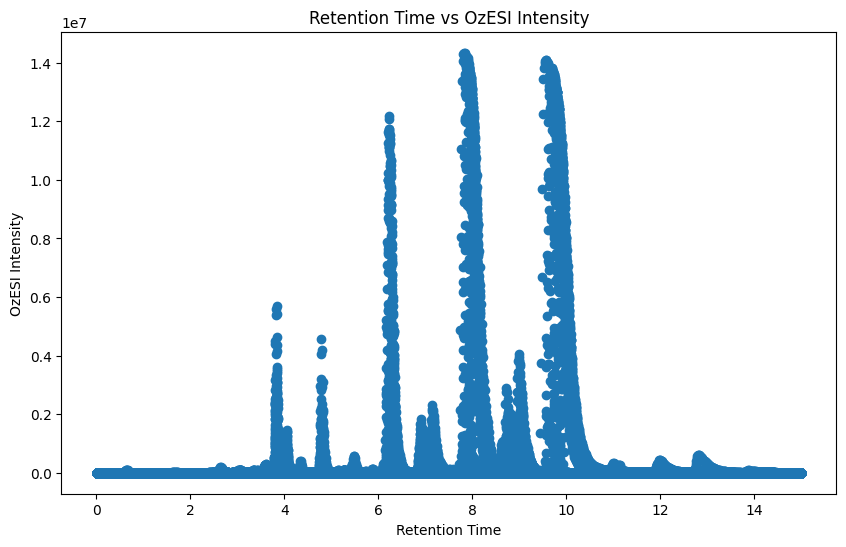

In [10]:
parser = OzESI.RawDataParser(mrm_csv_path, oze_esi_csv_path)


# Parse the data
parsed_data = parser.parse_data(retention_time_range, new_columns, group_columns, project_results_directory, file_name_to_save, mode)

# Save raw data
save_status = parser.save_raw_data(project_results_directory, file_name_to_save, mode)

# Plot the full spectrum
parser.plot_full_spectrum(raw_data_csv)

# Plot the full spectrum

In [11]:
read = pd.read_csv(raw_data_csv)
# Assuming the correct column name is identified as 'lipid_name'
unique_lipid_names = read['Lipid'].unique()
print(unique_lipid_names)




['12:1n-11 / 13:1n-12 / 14:1n-13 / 15:1n-14 / 16:1n-15 / 17:1n-16 / 18:1n-17 / 19:1n-18 / 20:1n-19 / 21:1n-20 / 22:1n-21 / 23:1n-22 / 24:1n-23 / 18:1n-17'
 '12:1n-10 / 13:1n-11 / 14:1n-12 / 15:1n-13 / 16:1n-14 / 17:1n-15 / 18:1n-16 / 19:1n-17 / 20:1n-18 / 21:1n-19 / 22:1n-20 / 23:1n-21 / 24:1n-22 / 18:1n-16'
 '4:0 / 12:1n-9 / 13:1n-10 / 14:1n-11 / 15:1n-12 / 16:1n-13 / 17:1n-14 / 18:1n-15 / 19:1n-16 / 20:1n-17 / 21:1n-18 / 22:1n-19 / 23:1n-20 / 24:1n-21 / 18:1n-15'
 '22:6 (4Z,7Z,10Z,13Z,16Z,19Z)n-3,n-6,n-9,n-12,n-15,n-18 / 12:1n-8 / 13:1n-9 / 14:1n-10 / 15:1n-11 / 16:1n-12 / 17:1n-13 / 18:1n-14 / 19:1n-15 / 20:1n-16 / 21:1n-17 / 22:1n-18 / 23:1n-19 / 24:1n-20 / 18:1n-14'
 '6:0 / 20:5 (5Z,8Z,11Z,14Z,17Z)n-3,n-6,n-9,n-12,n-15 / 20:4 (5Z,8Z,11Z,14Z)n-6,n-9,n-12,n-15 / 12:1n-7 / 13:1n-8 / 14:1n-9 / 15:1n-10 / 16:1n-11 / 17:1n-12 / 18:1n-13 / 19:1n-14 / 20:1n-15 / 21:1n-16 / 22:1n-17 / 23:1n-18 / 24:1n-19 / 18:1n-13'
 '18:3 (6Z,9Z,12Z))n-6,n-9,n-12 / 12:1n-6 / 13:1n-7 / 14:1n-8 / 15:1n-9 / 

In [12]:
# Print the parsed data
print(parsed_data)



RawDataParser complete, output saved to Projects/AMP/results/AMP/csv_data/AMP_RawDataParser_ON.csv


# PeakAnalysis Class
### find peaks, RT and peak area 
### input df from RawDataParser and output is df

In [91]:

# Create an instance of PeakAnalysis
peak_analysis = OzESI.PeakAnalysis(raw_data_csv, mode)

# Perform peak analysis
peaks_df = peak_analysis.find_lipid_peaks(use_match_group=True, height=5, width=2, rel_height=0.5, project_results=Project_results, file_name_to_save=file_name_to_save, user_input=mode)


Sampling Interval: 0.012900000000000002
Group_Sample: -1 - Peak 0: Start Time = 0.1795166666666666, End Time = 0.2182666666666666, Width = 0.03875000000000001, FWHM = 0.035475000000000007
Group_Sample: -1 - Peak 1: Start Time = 0.2441166666666666, End Time = 0.3087166666666667, Width = 0.0646000000000001, FWHM = 0.059157974325685043
Group_Sample: -1 - Peak 2: Start Time = 0.3862333333333334, End Time = 0.4508333333333333, Width = 0.06459999999999994, FWHM = 0.06127556385436696
Group_Sample: -1 - Peak 3: Start Time = 0.5154333333333334, End Time = 0.5671166666666667, Width = 0.0516833333333333, FWHM = 0.038701230211710944
Group_Sample: -1 - Peak 4: Start Time = 0.6317166666666667, End Time = 0.7350833333333334, Width = 0.10336666666666672, FWHM = 0.1071492793419201
Group_Sample: -1 - Peak 5: Start Time = 0.83845, End Time = 0.8642833333333334, Width = 0.025833333333333375, FWHM = 0.03225
Group_Sample: -1 - Peak 6: Start Time = 0.8901333333333333, End Time = 0.9547333333333334, Width = 0

In [92]:
peaks_df.tail(50)

############### WRITE A FUNCTION TO EASILY SCAN FOR SPECIFIC LIPIDS AN FIND THEIR MATCH GROUP OR GORUP SAMPLE
########## DOUBLE CHECK AREA CALCULATION
# Filter for Lipid 12:0 and Biology cereb
filter_for_lipid = peaks_df[
    (peaks_df['Lipid'].str.contains('18:1n-12')) & 
    (peaks_df['Biology'] == 'cereb') & 
    (peaks_df['Genotype'] == '5xFAD') & 
    (peaks_df['Mouse'] == 'm1') & 
    (peaks_df['Cage'] == 'FAD231')
]
filter_for_lipid


,Lipid,Retention_Time,OzESI_Intensity,Match_Group,Group_Sample,Sample_ID,Parent_Ion,Product_Ion,FAC,Biology,Genotype,Cage,Mouse,Peak_Height,FWHM,Peak_Width,Peak_Area
151991,"18:3 (6Z,9Z,12Z))n-6,n-9,n-12 / 12:1n-6 / 13:1...",0.075150,41.780003,236,845,11192023_5xFAD-m1-cereb-FAD231_AMP_2x_0.05uMd2...,297.2,183.0,"['18:3', '12:1', '13:1', '14:1', '15:1', '16:1...",cereb,5xFAD,FAD231,m1,41.780003,0.075250,0.077517,3.238647
151992,"18:3 (6Z,9Z,12Z))n-6,n-9,n-12 / 12:1n-6 / 13:1...",0.268950,47.280003,236,845,11192023_5xFAD-m1-cereb-FAD231_AMP_2x_0.05uMd2...,297.2,183.0,"['18:3', '12:1', '13:1', '14:1', '15:1', '16:1...",cereb,5xFAD,FAD231,m1,47.280003,0.059451,0.064600,3.054288
151993,"18:3 (6Z,9Z,12Z))n-6,n-9,n-12 / 12:1n-6 / 13:1...",0.359400,41.980003,236,845,11192023_5xFAD-m1-cereb-FAD231_AMP_2x_0.05uMd2...,297.2,183.0,"['18:3', '12:1', '13:1', '14:1', '15:1', '16:1...",cereb,5xFAD,FAD231,m1,41.980003,0.068800,0.077517,3.254150
151994,"18:3 (6Z,9Z,12Z))n-6,n-9,n-12 / 12:1n-6 / 13:1...",0.747000,730.660034,236,845,11192023_5xFAD-m1-cereb-FAD231_AMP_2x_0.05uMd2...,297.2,183.0,"['18:3', '12:1', '13:1', '14:1', '15:1', '16:1...",cereb,5xFAD,FAD231,m1,730.660034,0.062712,0.064600,47.200638
151995,"18:3 (6Z,9Z,12Z))n-6,n-9,n-12 / 12:1n-6 / 13:1...",0.927883,221.700012,236,845,11192023_5xFAD-m1-cereb-FAD231_AMP_2x_0.05uMd2...,297.2,183.0,"['18:3', '12:1', '13:1', '14:1', '15:1', '16:1...",cereb,5xFAD,FAD231,m1,221.700012,0.056909,0.051667,11.454501
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
152093,"18:3 (6Z,9Z,12Z))n-6,n-9,n-12 / 12:1n-6 / 13:1...",14.377967,41.700005,236,845,11192023_5xFAD-m1-cereb-FAD231_AMP_2x_0.05uMd2...,297.2,183.0,"['18:3', '12:1', '13:1', '14:1', '15:1', '16:1...",cereb,5xFAD,FAD231,m1,41.700005,0.177374,0.167967,7.004211
152094,"18:3 (6Z,9Z,12Z))n-6,n-9,n-12 / 12:1n-6 / 13:1...",14.571783,41.680004,236,845,11192023_5xFAD-m1-cereb-FAD231_AMP_2x_0.05uMd2...,297.2,183.0,"['18:3', '12:1', '13:1', '14:1', '15:1', '16:1...",cereb,5xFAD,FAD231,m1,41.680004,0.072561,0.077517,3.230895
152095,"18:3 (6Z,9Z,12Z))n-6,n-9,n-12 / 12:1n-6 / 13:1...",14.662217,41.600002,236,845,11192023_5xFAD-m1-cereb-FAD231_AMP_2x_0.05uMd2...,297.2,183.0,"['18:3', '12:1', '13:1', '14:1', '15:1', '16:1...",cereb,5xFAD,FAD231,m1,41.600002,0.038699,0.038767,1.612693
152096,"18:3 (6Z,9Z,12Z))n-6,n-9,n-12 / 12:1n-6 / 13:1...",14.778500,41.660004,236,845,11192023_5xFAD-m1-cereb-FAD231_AMP_2x_0.05uMd2...,297.2,183.0,"['18:3', '12:1', '13:1', '14:1', '15:1', '16:1...",cereb,5xFAD,FAD231,m1,41.660004,0.056436,0.051667,2.152434


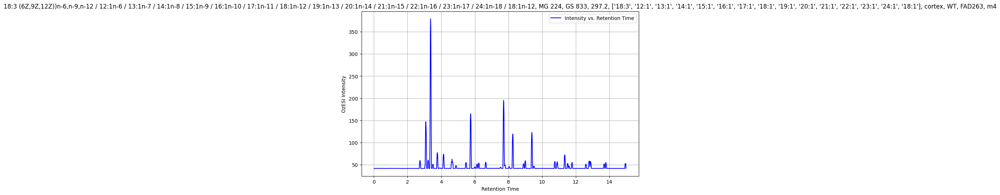

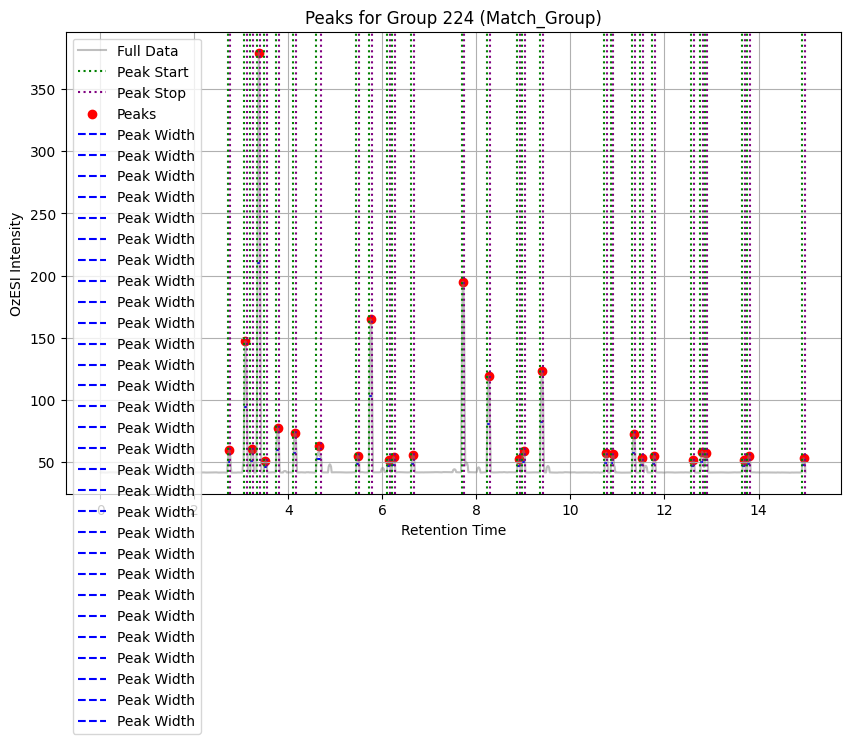

In [93]:

# Plot data and peaks for a specific group
peak_analysis.plot_data_and_peaks(raw_data_csv, peak_analysis_csv,group_type='Match_Group', group_value=224, height=50, width=2, rel_height=0.5)

In [16]:
peaks_df

,Lipid,Retention_Time,OzESI_Intensity,Match_Group,Group_Sample,Sample_ID,Parent_Ion,Product_Ion,FAC,Biology,Genotype,Cage,Mouse,Peak_Height,FWHM,Peak_Width,Peak_Area
0,12:1n-11 / 13:1n-12 / 14:1n-13 / 15:1n-14 / 16...,10.011900,2340.920166,0,-1,11162023_Blank-AMP_2x_MRMs_O3on_01,227.1,183.0,"['12:1', '13:1', '14:1', '15:1', '16:1', '17:1...",NaN,NaN,NaN,NaN,2340.920166,0.184016,0.180883,423.433443
1,4:0 / 12:1n-9 / 13:1n-10 / 14:1n-11 / 15:1n-12...,0.683000,6303.520508,84,-1,11162023_Blank-AMP_2x_MRMs_O3on_01,255.2,183.0,"['4:0', '12:1', '13:1', '14:1', '15:1', '16:1'...",NaN,NaN,NaN,NaN,6303.520508,0.089841,0.090450,570.153430
2,"22:6 (4Z,7Z,10Z,13Z,16Z,19Z)n-3,n-6,n-9,n-12,n...",2.659617,5222.000488,126,-1,11162023_Blank-AMP_2x_MRMs_O3on_01,269.1,183.0,"['22:6', '12:1', '13:1', '14:1', '15:1', '16:1...",NaN,NaN,NaN,NaN,5222.000488,0.077235,0.077517,404.792071
3,"6:0 / 20:5 (5Z,8Z,11Z,14Z,17Z)n-3,n-6,n-9,n-12...",0.643833,35215.703125,168,-1,11162023_Blank-AMP_2x_MRMs_O3on_01,283.2,183.0,"['6:0', '20:5', '20:4', '12:1', '13:1', '14:1'...",NaN,NaN,NaN,NaN,35215.703125,0.062973,0.064600,2274.934422
4,"6:0 / 20:5 (5Z,8Z,11Z,14Z,17Z)n-3,n-6,n-9,n-12...",1.134817,876.140076,168,-1,11162023_Blank-AMP_2x_MRMs_O3on_01,283.2,183.0,"['6:0', '20:5', '20:4', '12:1', '13:1', '14:1'...",NaN,NaN,NaN,NaN,876.140076,0.067416,0.064600,56.598649
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21176,22:0 / 23:1n-2 / 24:1n-3,13.955300,8622.200195,2141,1557,11192023_5xFAD-m2-hippo-FAD257_AMP_2x_0.05uMd2...,507.4,183.0,"['22:0', '23:1', '24:1']",hippo,5xFAD,FAD257,m2,8622.200195,0.198041,0.206733,1782.496187
21177,22:0 / 23:1n-2 / 24:1n-3,14.329983,2236.240234,2141,1557,11192023_5xFAD-m2-hippo-FAD257_AMP_2x_0.05uMd2...,507.4,183.0,"['22:0', '23:1', '24:1']",hippo,5xFAD,FAD257,m2,2236.240234,0.045934,0.038750,86.654309
21178,22:0 / 23:1n-2 / 24:1n-3,14.497950,1194.780029,2141,1557,11192023_5xFAD-m2-hippo-FAD257_AMP_2x_0.05uMd2...,507.4,183.0,"['22:0', '23:1', '24:1']",hippo,5xFAD,FAD257,m2,1194.780029,0.048120,0.051683,61.750215
21179,22:0 / 23:1n-2 / 24:1n-3,14.588400,1144.640137,2141,1557,11192023_5xFAD-m2-hippo-FAD257_AMP_2x_0.05uMd2...,507.4,183.0,"['22:0', '23:1', '24:1']",hippo,5xFAD,FAD257,m2,1144.640137,0.026005,0.038767,44.373883


# OZONE COMPARE

############################################

In [17]:

# # Create an instance of OzoneCompare

# # # Paths to the ON and OFF CSV files
# # peak_analysis_csv_on = f"{file_name_to_save}_PeakAnalysis_ON.csv"
# # peak_analysis_csv_off = f"{file_name_to_save}_PeakAnalysis_OFF.csv"





# # # Path to OzoneCompare output file
# # ozone_compare_csv = f"{file_name_to_save}_OzoneCompared.csv"

# # Print the paths of each input being used
# print(f"CSV data folder: {csv_data_folder}")
# print(f"Peak Analysis ON file: {os.path.join(csv_data_folder, peak_analysis_csv_on)}")
# print(f"Peak Analysis OFF file: {os.path.join(csv_data_folder, peak_analysis_csv_off)}")
# print(f"Ozone Compare output file: {os.path.join(csv_data_folder, ozone_compare_csv)}")

# # Create an instance of OzoneCompare
# ozone_compare = OzoneCompare(csv_data_folder, peak_analysis_csv_on, peak_analysis_csv_off, ozone_compare_csv)

# # Match the dataframes
# matched_df = ozone_compare.match_dataframes()

# # Filter the matched DataFrame if needed
# filtered_df = ozone_compare.filter_contains_colon_zero(matched_df)

# # Save the matched DataFrame to a CSV file
# ozone_compare.save_matched_data(filtered_df)

# # Print the path where the Ozone matched CSV file was saved
# output_path = os.path.join(csv_data_folder, ozone_compare_csv)
# print(f"Process completed. Matched data saved to {output_path}")



# NEW OzoneCompare for 18:1 only

# ################ #######################

In [23]:
import pandas as pd
import ast
import os
from tqdm import tqdm

class OzoneCompare:
    def __init__(self, csv_data_folder, file_name_on, file_name_off, output_file_name, specific_fac):
        self.csv_data_folder = csv_data_folder
        self.file_name_on = file_name_on
        self.file_name_off = file_name_off
        self.output_file_name = output_file_name
        self.specific_fac = specific_fac
        self.load_data()

    def load_data(self):
        # Ensure directory has a trailing slash
        if not self.csv_data_folder.endswith('/'):
            self.csv_data_folder += '/'
        
        # Load data from CSV files
        self.OzON_df = pd.read_csv(os.path.join(self.csv_data_folder, self.file_name_on))
        print(f"Loaded ON data: {self.OzON_df.head()}")  # Debugging print statement
        self.OzOFF_df = pd.read_csv(os.path.join(self.csv_data_folder, self.file_name_off))
        print(f"Loaded OFF data: {self.OzOFF_df.head()}")  # Debugging print statement
        
        # Drop 'Unnamed: 0' columns if they exist
        self.OzON_df.drop(columns='Unnamed: 0', errors='ignore', inplace=True)
        self.OzOFF_df.drop(columns='Unnamed: 0', errors='ignore', inplace=True)

        # Filter for the specific FAC
        self.OzON_df = self.filter_for_specific_fac(self.OzON_df, self.specific_fac)
        self.OzOFF_df = self.filter_for_specific_fac(self.OzOFF_df, self.specific_fac)

    def filter_for_specific_fac(self, df, specific_fac):
        filtered_df = df[df['FAC'].apply(lambda x: specific_fac in ast.literal_eval(x))]
        print(f"Data filtered for {specific_fac}: {filtered_df.head()}")  # Debugging print statement
        return filtered_df

    def match_dataframes(self):
        matched = pd.DataFrame(columns=self.OzON_df.columns.tolist() + ['FAC_OFF', 'Retention_Time_OFF'])
        for _, on_row in tqdm(self.OzON_df.iterrows(), total=self.OzON_df.shape[0], desc='Processing ON data'):
            try:
                on_fac_list = ast.literal_eval(on_row['FAC'])
            except (ValueError, SyntaxError):
                continue  # Skip rows where 'FAC' cannot be parsed
                
            for _, off_row in tqdm(self.OzOFF_df.iterrows(), total=self.OzOFF_df.shape[0], desc='Processing OFF data', leave=False):
                try:
                    off_fac_list = ast.literal_eval(off_row['FAC'])
                except (ValueError, SyntaxError):
                    continue  # Skip rows where 'FAC' cannot be parsed
                
                for on_fac in on_fac_list:
                    if on_fac in off_fac_list and abs(on_row['Retention_Time'] - off_row['Retention_Time']) <= 0.5:
                        new_row = on_row.copy()
                        new_row['FAC_OFF'] = on_fac
                        new_row['Retention_Time_OFF'] = off_row['Retention_Time']
                        matched = matched.append(new_row, ignore_index=True)
        
        print(f"Matched data: {matched.head()}")  # Debugging print statement
        return matched

    def filter_contains_colon_zero(self, df):
        filtered_df = df[df['FAC_OFF'].apply(lambda x: ':0' not in x)]
        print(f"Filtered data: {filtered_df.head()}")  # Debugging print statement
        return filtered_df
    
    def save_matched_data(self, matched_df):
        output_path = os.path.join(self.csv_data_folder, self.output_file_name)
        matched_df.to_csv(output_path, index=False)
        print(f"Matched data saved to {output_path}")  # Debugging print statement


# Define file paths and names


specific_fac = '18:1'

# Print the paths of each input being used
print(f"CSV data folder: {csv_data_folder}")
print(f"Peak Analysis ON file: {os.path.join(csv_data_folder, peak_analysis_csv_on)}")
print(f"Peak Analysis OFF file: {os.path.join(csv_data_folder, peak_analysis_csv_off)}")
print(f"Ozone Compare output file: {os.path.join(csv_data_folder, ozone_compare_csv)}")

# Create an instance of OzoneCompare
ozone_compare = OzoneCompare(csv_data_folder, peak_analysis_csv_on, peak_analysis_csv_off, ozone_compare_csv, specific_fac)

# Match the dataframes
matched_df = ozone_compare.match_dataframes()

# Filter the matched DataFrame if needed
filtered_df = ozone_compare.filter_contains_colon_zero(matched_df)

# Save the matched DataFrame to a CSV file
ozone_compare.save_matched_data(filtered_df)

# Print the path where the Ozone matched CSV file was saved
output_path = os.path.join(csv_data_folder, ozone_compare_csv)
print(f"Process completed. Matched data saved to {output_path}")


CSV data folder: ./Projects/AMP/results/AMP/csv_data/
Peak Analysis ON file: ./Projects/AMP/results/AMP/csv_data/AMP_PeakAnalysis_ON.csv
Peak Analysis OFF file: ./Projects/AMP/results/AMP/csv_data/AMP_PeakAnalysis_OFF.csv
Ozone Compare output file: ./Projects/AMP/results/AMP/csv_data/AMP_OzoneCompared.csv
Loaded ON data:                                                Lipid  Retention_Time  \
0  12:1n-11 / 13:1n-12 / 14:1n-13 / 15:1n-14 / 16...       10.011900   
1  4:0 / 12:1n-9 / 13:1n-10 / 14:1n-11 / 15:1n-12...        0.683000   
2  22:6 (4Z,7Z,10Z,13Z,16Z,19Z)n-3,n-6,n-9,n-12,n...        2.659617   
3  6:0 / 20:5 (5Z,8Z,11Z,14Z,17Z)n-3,n-6,n-9,n-12...        0.643833   
4  6:0 / 20:5 (5Z,8Z,11Z,14Z,17Z)n-3,n-6,n-9,n-12...        1.134817   

   OzESI_Intensity  Match_Group  Group_Sample  \
0      2340.920166            0            -1   
1      6303.520508           84            -1   
2      5222.000488          126            -1   
3     35215.703125          168            -1   

Processing ON data: 100%|██████████| 11358/11358 [1:29:40<00:00,  2.11it/s] 


Matched data:                                                Lipid  Retention_Time  \
0  18:3 (6Z,9Z,12Z))n-6,n-9,n-12 / 12:1n-6 / 13:1...        9.041867   
1  18:3 (6Z,9Z,12Z))n-6,n-9,n-12 / 12:1n-6 / 13:1...        9.041867   
2  18:3 (6Z,9Z,12Z))n-6,n-9,n-12 / 12:1n-6 / 13:1...        9.041867   
3  18:3 (6Z,9Z,12Z))n-6,n-9,n-12 / 12:1n-6 / 13:1...        9.041867   
4  18:3 (6Z,9Z,12Z))n-6,n-9,n-12 / 12:1n-6 / 13:1...        9.041867   

   OzESI_Intensity Match_Group Group_Sample  \
0       594.080017         210           -1   
1       594.080017         210           -1   
2       594.080017         210           -1   
3       594.080017         210           -1   
4       594.080017         210           -1   

                            Sample_ID  Parent_Ion  Product_Ion  \
0  11162023_Blank-AMP_2x_MRMs_O3on_01       297.2        183.0   
1  11162023_Blank-AMP_2x_MRMs_O3on_01       297.2        183.0   
2  11162023_Blank-AMP_2x_MRMs_O3on_01       297.2        183.0   
3  111

# Load in 18:1 Data and plot

In [28]:
output_path = os.path.join(csv_data_folder, ozone_compare_csv)
df = pd.read_csv(output_path)
#save to output folder
print(f'{csv_data_folder}AMP_OzoneCompared_working_v4.csv')
df.to_csv(f'{csv_data_folder}AMP_OzoneCompared_working_v4.csv')
df

./Projects/AMP/results/AMP/csv_data/AMP_OzoneCompared_working_v4.csv


,Lipid,Retention_Time,OzESI_Intensity,Match_Group,Group_Sample,Sample_ID,Parent_Ion,Product_Ion,FAC,Biology,Genotype,Cage,Mouse,Peak_Height,FWHM,Peak_Width,Peak_Area,FAC_OFF,Retention_Time_OFF
0,"18:3 (6Z,9Z,12Z))n-6,n-9,n-12 / 12:1n-6 / 13:1...",9.041867,594.080017,210,-1,11162023_Blank-AMP_2x_MRMs_O3on_01,297.2,183.0,"['18:3', '12:1', '13:1', '14:1', '15:1', '16:1...",NaN,NaN,NaN,NaN,594.080017,0.095435,0.103367,61.408071,18:1,8.738150
1,"18:3 (6Z,9Z,12Z))n-6,n-9,n-12 / 12:1n-6 / 13:1...",9.041867,594.080017,210,-1,11162023_Blank-AMP_2x_MRMs_O3on_01,297.2,183.0,"['18:3', '12:1', '13:1', '14:1', '15:1', '16:1...",NaN,NaN,NaN,NaN,594.080017,0.095435,0.103367,61.408071,18:1,8.738150
2,"18:3 (6Z,9Z,12Z))n-6,n-9,n-12 / 12:1n-6 / 13:1...",9.041867,594.080017,210,-1,11162023_Blank-AMP_2x_MRMs_O3on_01,297.2,183.0,"['18:3', '12:1', '13:1', '14:1', '15:1', '16:1...",NaN,NaN,NaN,NaN,594.080017,0.095435,0.103367,61.408071,18:1,9.022400
3,"18:3 (6Z,9Z,12Z))n-6,n-9,n-12 / 12:1n-6 / 13:1...",9.041867,594.080017,210,-1,11162023_Blank-AMP_2x_MRMs_O3on_01,297.2,183.0,"['18:3', '12:1', '13:1', '14:1', '15:1', '16:1...",NaN,NaN,NaN,NaN,594.080017,0.095435,0.103367,61.408071,18:1,9.022400
4,"18:3 (6Z,9Z,12Z))n-6,n-9,n-12 / 12:1n-6 / 13:1...",9.041867,594.080017,210,-1,11162023_Blank-AMP_2x_MRMs_O3on_01,297.2,183.0,"['18:3', '12:1', '13:1', '14:1', '15:1', '16:1...",NaN,NaN,NaN,NaN,594.080017,0.095435,0.103367,61.408071,18:1,8.686483
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
218942,18:1,9.745950,4098.060059,1595,614,11192023_5xFAD-m2-hippo-FAD257_AMP_2x_0.05uMd2...,449.4,183.0,['18:1'],hippo,5xFAD,FAD257,m2,4098.060059,0.140487,0.142133,582.470936,18:1,9.306667
218943,18:1,9.745950,4098.060059,1595,614,11192023_5xFAD-m2-hippo-FAD257_AMP_2x_0.05uMd2...,449.4,183.0,['18:1'],hippo,5xFAD,FAD257,m2,4098.060059,0.140487,0.142133,582.470936,18:1,9.293767
218944,18:1,9.745950,4098.060059,1595,614,11192023_5xFAD-m2-hippo-FAD257_AMP_2x_0.05uMd2...,449.4,183.0,['18:1'],hippo,5xFAD,FAD257,m2,4098.060059,0.140487,0.142133,582.470936,18:1,9.293733
218945,18:1,9.745950,4098.060059,1595,614,11192023_5xFAD-m2-hippo-FAD257_AMP_2x_0.05uMd2...,449.4,183.0,['18:1'],hippo,5xFAD,FAD257,m2,4098.060059,0.140487,0.142133,582.470936,18:1,9.306650


# Clean Lipid column for 18:1 lipids

In [29]:
import pandas as pd

def clean_specific_lipid(df, lipid_pattern):
    """
    This function takes a DataFrame and a lipid pattern (e.g., '18:1'),
    searches for lipids in the Lipid column that contain the specified pattern,
    and retains only those lipids, removing all others.

    Parameters:
    df (pd.DataFrame): The input DataFrame containing a 'Lipid' column.
    lipid_pattern (str): The lipid pattern to search for (e.g., '18:1').

    Returns:
    pd.DataFrame: A DataFrame with the Lipid column cleaned.
    """
    def filter_lipids(lipid_str, pattern):
        lipids = lipid_str.split(' / ')
        filtered_lipids = [lipid for lipid in lipids if pattern in lipid]
        return ' / '.join(filtered_lipids)
    
    df['Lipid'] = df['Lipid'].apply(lambda x: filter_lipids(x, lipid_pattern))
    return df


cleaned_df = clean_specific_lipid(df, '18:1')
#to csv file in csv file folder
#print where its being saved 
print(f"Saving cleaned data to {csv_data_folder}OzON_match/df_OzESI_{mode}_cleaned_v3.csv")
cleaned_df.to_csv(f'{csv_data_folder}OzON_match/df_OzESI_{mode}_cleaned_v3.csv')
cleaned_df


Saving cleaned data to ./Projects/AMP/results/AMP/csv_data/OzON_match/df_OzESI_ON_cleaned_v3.csv


,Lipid,Retention_Time,OzESI_Intensity,Match_Group,Group_Sample,Sample_ID,Parent_Ion,Product_Ion,FAC,Biology,Genotype,Cage,Mouse,Peak_Height,FWHM,Peak_Width,Peak_Area,FAC_OFF,Retention_Time_OFF
0,18:1n-12 / 18:1n-12,9.041867,594.080017,210,-1,11162023_Blank-AMP_2x_MRMs_O3on_01,297.2,183.0,"['18:3', '12:1', '13:1', '14:1', '15:1', '16:1...",NaN,NaN,NaN,NaN,594.080017,0.095435,0.103367,61.408071,18:1,8.738150
1,18:1n-12 / 18:1n-12,9.041867,594.080017,210,-1,11162023_Blank-AMP_2x_MRMs_O3on_01,297.2,183.0,"['18:3', '12:1', '13:1', '14:1', '15:1', '16:1...",NaN,NaN,NaN,NaN,594.080017,0.095435,0.103367,61.408071,18:1,8.738150
2,18:1n-12 / 18:1n-12,9.041867,594.080017,210,-1,11162023_Blank-AMP_2x_MRMs_O3on_01,297.2,183.0,"['18:3', '12:1', '13:1', '14:1', '15:1', '16:1...",NaN,NaN,NaN,NaN,594.080017,0.095435,0.103367,61.408071,18:1,9.022400
3,18:1n-12 / 18:1n-12,9.041867,594.080017,210,-1,11162023_Blank-AMP_2x_MRMs_O3on_01,297.2,183.0,"['18:3', '12:1', '13:1', '14:1', '15:1', '16:1...",NaN,NaN,NaN,NaN,594.080017,0.095435,0.103367,61.408071,18:1,9.022400
4,18:1n-12 / 18:1n-12,9.041867,594.080017,210,-1,11162023_Blank-AMP_2x_MRMs_O3on_01,297.2,183.0,"['18:3', '12:1', '13:1', '14:1', '15:1', '16:1...",NaN,NaN,NaN,NaN,594.080017,0.095435,0.103367,61.408071,18:1,8.686483
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
218942,18:1,9.745950,4098.060059,1595,614,11192023_5xFAD-m2-hippo-FAD257_AMP_2x_0.05uMd2...,449.4,183.0,['18:1'],hippo,5xFAD,FAD257,m2,4098.060059,0.140487,0.142133,582.470936,18:1,9.306667
218943,18:1,9.745950,4098.060059,1595,614,11192023_5xFAD-m2-hippo-FAD257_AMP_2x_0.05uMd2...,449.4,183.0,['18:1'],hippo,5xFAD,FAD257,m2,4098.060059,0.140487,0.142133,582.470936,18:1,9.293767
218944,18:1,9.745950,4098.060059,1595,614,11192023_5xFAD-m2-hippo-FAD257_AMP_2x_0.05uMd2...,449.4,183.0,['18:1'],hippo,5xFAD,FAD257,m2,4098.060059,0.140487,0.142133,582.470936,18:1,9.293733
218945,18:1,9.745950,4098.060059,1595,614,11192023_5xFAD-m2-hippo-FAD257_AMP_2x_0.05uMd2...,449.4,183.0,['18:1'],hippo,5xFAD,FAD257,m2,4098.060059,0.140487,0.142133,582.470936,18:1,9.306650


# remove duplicates keep top 3 for each Lipid

In [30]:
import pandas as pd

def get_top_n_lipids_by_group_and_intensity(df, top_n=3):
    """
    This function takes a cleaned DataFrame and returns the top N lipids
    based on the highest OzESI_Intensity for each Group_Sample and lipid pattern.

    Parameters:
    df (pd.DataFrame): The cleaned DataFrame containing 'Group_Sample', 'Lipid', and 'OzESI_Intensity' columns.
    top_n (int): The number of top lipids to return based on OzESI_Intensity.

    Returns:
    pd.DataFrame: A DataFrame with the top N lipids based on OzESI_Intensity for each Group_Sample.
    """
    # Sort the DataFrame by Group_Sample, Lipid, and OzESI_Intensity in descending order
    df_sorted = df.sort_values(by=['Group_Sample', 'Lipid', 'OzESI_Intensity'], ascending=[True, True, False])
    
    # Group by Group_Sample and Lipid, then get the top N entries for each group
    top_n_lipids = df_sorted.groupby(['Group_Sample', 'Lipid']).head(top_n).reset_index(drop=True)
    
    return top_n_lipids

# Example usage
top_lipids = 1  # Specify the number of top lipids you want
top_n_lipids = get_top_n_lipids_by_group_and_intensity(cleaned_df, top_n=top_lipids)

# Print the top N lipids and save to a CSV file
csv_file_path = f'{csv_data_folder}OzON_match/top_{top_lipids}_lipids_{mode}_v3.csv'
print(f'Saving top {top_lipids} lipids to {csv_file_path}_v3')
top_n_lipids.to_csv(csv_file_path, index=False)

top_n_lipids


Saving top 1 lipids to ./Projects/AMP/results/AMP/csv_data/OzON_match/top_1_lipids_ON_v3.csv_v3


,Lipid,Retention_Time,OzESI_Intensity,Match_Group,Group_Sample,Sample_ID,Parent_Ion,Product_Ion,FAC,Biology,Genotype,Cage,Mouse,Peak_Height,FWHM,Peak_Width,Peak_Area,FAC_OFF,Retention_Time_OFF
0,18:1,8.725233,129558.265625,1554,-1,11162023_Blank-AMP_2x_MRMs_O3on_01,449.4,183.0,['18:1'],NaN,NaN,NaN,NaN,129558.265625,0.198288,0.193800,25108.391878,18:1,8.738150
1,18:1(9Z)n-9 / 18:1n-9,8.730567,23199.841797,462,-1,11162023_Blank-AMP_2x_MRMs_O3on_01,339.3,183.0,"['10:0', '18:2', '14:1', '18:3', '16:1', '18:1...",NaN,NaN,NaN,NaN,23199.841797,0.097910,0.103367,2398.090314,18:1,8.738150
2,18:1n-10 / 18:1n-10,8.847250,4801.880371,378,-1,11162023_Blank-AMP_2x_MRMs_O3on_01,325.2,183.0,"['20:3', '12:1', '13:1', '14:1', '15:1', '16:1...",NaN,NaN,NaN,NaN,4801.880371,0.144216,0.142117,682.427232,18:1,8.738150
3,18:1n-12 / 18:1n-12,9.041867,594.080017,210,-1,11162023_Blank-AMP_2x_MRMs_O3on_01,297.2,183.0,"['18:3', '12:1', '13:1', '14:1', '15:1', '16:1...",NaN,NaN,NaN,NaN,594.080017,0.095435,0.103367,61.408071,18:1,8.738150
4,18:1n-2,9.126583,561711.625000,1386,-1,11162023_Blank-AMP_2x_MRMs_O3on_01,437.4,183.0,"['17:0', '19:1', '20:1', '21:1', '22:1', '23:1...",NaN,NaN,NaN,NaN,561711.625000,0.176776,0.167967,94348.829279,18:1,8.738150
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
532,18:1n-11 / 18:1n-11,9.067300,757.300049,328,2165,11192023_5xFAD-m2-cereb-FAD231_AMP_2x_0.05uMd2...,311.3,183.0,"['8:0', '12:1', '13:1', '14:1', '15:1', '16:1'...",cereb,5xFAD,FAD231,m2,757.300049,0.148530,0.155033,117.406751,18:1,8.738150
533,18:1n-11 / 18:1n-11,9.015617,598.420044,329,2166,11192023_5xFAD-m2-cereb-FAD257_AMP_2x_0.05uMd2...,311.3,183.0,"['8:0', '12:1', '13:1', '14:1', '15:1', '16:1'...",cereb,5xFAD,FAD257,m2,598.420044,0.090916,0.090433,54.117119,18:1,8.738150
534,18:1n-11 / 18:1n-11,9.855450,688.360046,332,2169,11192023_5xFAD-m2-dienc-FAD231_AMP_2x_0.05uMd2...,311.3,183.0,"['8:0', '12:1', '13:1', '14:1', '15:1', '16:1'...",dienc,5xFAD,FAD231,m2,688.360046,0.118715,0.116283,80.044801,18:1,9.371267
535,18:1n-11 / 18:1n-11,9.093133,1028.260132,334,2171,11192023_5xFAD-m2-hippo-FAD231_AMP_2x_0.05uMd2...,311.3,183.0,"['8:0', '12:1', '13:1', '14:1', '15:1', '16:1'...",hippo,5xFAD,FAD231,m2,1028.260132,0.088790,0.090450,93.006129,18:1,8.738150


# RETENTION TIME FILTER

In [75]:
import pandas as pd

def filter_by_retention_time(df, target_retention_time, tolerance=0.9):
    """
    This function filters the DataFrame by Retention_Time, keeping only rows where
    the Retention_Time is within the specified tolerance of the target_retention_time.

    Parameters:
    df (pd.DataFrame): The input DataFrame containing a 'Retention_Time' column.
    target_retention_time (float): The target retention time to filter around.
    tolerance (float): The tolerance window around the target retention time (default is 0.3).

    Returns:
    pd.DataFrame: A filtered DataFrame with rows within the specified retention time window.
    """
    lower_bound = target_retention_time - tolerance
    upper_bound = target_retention_time + tolerance
    
    filtered_df = df[(df['Retention_Time'] >= lower_bound) & (df['Retention_Time'] <= upper_bound)]
    return filtered_df

def sort_by_columns(df, columns):
    """
    This function sorts the DataFrame by the specified columns.

    Parameters:
    df (pd.DataFrame): The input DataFrame to be sorted.
    columns (list): A list of column names to sort by.

    Returns:
    pd.DataFrame: A sorted DataFrame.
    """
    sorted_df = df.sort_values(by=columns)
    return sorted_df

# Assuming top_n_lipids, csv_data_folder, top_lipids, and mode are already defined
target_retention_time = 8.7
filtered_df = filter_by_retention_time(top_n_lipids, target_retention_time)
sorted_filtered_df = sort_by_columns(filtered_df, ['Lipid', 'Biology', 'Genotype'])

output_filename = f'{csv_data_folder}OzON_match/top_{top_lipids}_lipids_{mode}_filtered_v3.csv'
print(f'Saving filtered and sorted data to {output_filename}_v3')
sorted_filtered_df.to_csv(output_filename, index=False)

sorted_filtered_df


Saving filtered and sorted data to ./Projects/AMP/results/AMP/csv_data/OzON_match/top_1_lipids_ON_filtered_v3.csv_v3


,Lipid,Retention_Time,OzESI_Intensity,Match_Group,Group_Sample,Sample_ID,Parent_Ion,Product_Ion,FAC,Biology,Genotype,Cage,Mouse,Peak_Height,FWHM,Peak_Width,Peak_Area,FAC_OFF,Retention_Time_OFF
412,18:1,8.673567,496649.062500,1580,599,11192023_5xFAD-m1-cereb-FAD231_AMP_2x_0.05uMd2...,449.4,183.0,['18:1'],cereb,5xFAD,FAD231,m1,496649.062500,0.106190,0.103367,51336.958094,18:1,8.738150
413,18:1,8.647700,376121.875000,1581,600,11192023_5xFAD-m1-cereb-FAD249_AMP_2x_0.05uMd2...,449.4,183.0,['18:1'],cereb,5xFAD,FAD249,m1,376121.875000,0.122981,0.129217,48601.214948,18:1,8.738150
420,18:1,8.660633,399350.343750,1588,607,11192023_5xFAD-m2-cereb-FAD231_AMP_2x_0.05uMd2...,449.4,183.0,['18:1'],cereb,5xFAD,FAD231,m2,399350.343750,0.112686,0.116283,46437.789139,18:1,8.738150
421,18:1,8.647700,299305.968750,1589,608,11192023_5xFAD-m2-cereb-FAD257_AMP_2x_0.05uMd2...,449.4,183.0,['18:1'],cereb,5xFAD,FAD257,m2,299305.968750,0.118907,0.116283,34804.295733,18:1,8.738150
388,18:1,8.673567,186620.515625,1555,574,11162023_WT-m1-cereb-FAD245_AMP_2x_0.05uMd216-...,449.4,183.0,['18:1'],cereb,WT,FAD245,m1,186620.515625,0.095035,0.090450,16879.825638,18:1,8.738150
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
366,"22:2 (13Z,16Z)n-6, 18:1n-2",8.144867,12081.940430,1356,503,11162023_WT-m3-hippo-FAD263_AMP_2x_0.05uMd216-...,435.4,183.0,"['17:1', '22:2', '18:1']",hippo,WT,FAD263,m3,12081.940430,0.187213,0.180883,2185.421658,18:1,8.634783
370,"22:2 (13Z,16Z)n-6, 18:1n-2",8.157783,5428.420410,1361,508,11162023_WT-m4-hippo-FAD263_AMP_2x_0.05uMd216-...,435.4,183.0,"['17:1', '22:2', '18:1']",hippo,WT,FAD263,m4,5428.420410,0.125999,0.129200,701.351917,18:1,8.647733
376,"22:2 (13Z,16Z)n-6, 18:1n-2",8.894233,1235.420044,1368,515,11162023_WT-m5-hippo-FAD259_AMP_2x_0.05uMd216-...,435.4,183.0,"['17:1', '22:2', '18:1']",hippo,WT,FAD259,m5,1235.420044,0.102044,0.090450,111.743743,18:1,8.738150
377,"22:2 (13Z,16Z)n-6, 18:1n-2",8.920050,1275.780029,1369,516,11162023_WT-m5-hippo-FAD263_AMP_2x_0.05uMd216-...,435.4,183.0,"['17:1', '22:2', '18:1']",hippo,WT,FAD263,m5,1275.780029,0.127123,0.129200,164.830780,18:1,8.738150


In [76]:
filter_for_lipid = sorted_filtered_df[
    (sorted_filtered_df['Lipid'].str.contains('n-12')) & 
     (sorted_filtered_df['Biology'] == 'cereb') #& 
    # (sorted_filtered_df['Genotype'] == '5xFAD') & 
    # (sorted_filtered_df['Mouse'] == 'm1') & 
    # (sorted_filtered_df['Cage'] == 'FAD231')
]
filter_for_lipid

,Lipid,Retention_Time,OzESI_Intensity,Match_Group,Group_Sample,Sample_ID,Parent_Ion,Product_Ion,FAC,Biology,Genotype,Cage,Mouse,Peak_Height,FWHM,Peak_Width,Peak_Area,FAC_OFF,Retention_Time_OFF
444,18:1n-12 / 18:1n-12,9.145233,729.680054,237,846,11192023_5xFAD-m1-cereb-FAD249_AMP_2x_0.05uMd2...,297.2,183.0,"['18:3', '12:1', '13:1', '14:1', '15:1', '16:1...",cereb,5xFAD,FAD249,m1,729.680054,0.091984,0.090450,65.999561,18:1,8.73815
434,18:1n-12 / 18:1n-12,9.041883,652.300049,223,832,11162023_WT-m4-cereb-FAD263_AMP_2x_0.05uMd216-...,297.2,183.0,"['18:3', '12:1', '13:1', '14:1', '15:1', '16:1...",cereb,WT,FAD263,m4,652.300049,0.071007,0.077517,50.564125,18:1,8.73815
437,18:1n-12 / 18:1n-12,9.158167,1021.540100,228,837,11162023_WT-m5-cereb-FAD259_AMP_2x_0.05uMd216-...,297.2,183.0,"['18:3', '12:1', '13:1', '14:1', '15:1', '16:1...",cereb,WT,FAD259,m5,1021.540100,0.092034,0.090433,92.381276,18:1,8.73815
438,18:1n-12 / 18:1n-12,9.158150,874.700073,229,838,11162023_WT-m5-cereb-FAD263_AMP_2x_0.05uMd216-...,297.2,183.0,"['18:3', '12:1', '13:1', '14:1', '15:1', '16:1...",cereb,WT,FAD263,m5,874.700073,0.088083,0.090450,79.116622,18:1,8.73815


# ozzzzz

# OZONE COMPARE MADE FASTER

# oz faster##

In [96]:
import pandas as pd

def clean_specific_lipid(df, lipid_pattern):
    """
    This function takes a DataFrame and a lipid pattern (e.g., '18:1'),
    searches for lipids in the Lipid column that contain the specified pattern,
    and retains only those lipids, removing all others.

    Parameters:
    df (pd.DataFrame): The input DataFrame containing a 'Lipid' column.
    lipid_pattern (str): The lipid pattern to search for (e.g., '18:1').

    Returns:
    pd.DataFrame: A DataFrame with the Lipid column cleaned.
    """
    def filter_lipids(lipid_str, pattern):
        lipids = lipid_str.split(' / ')
        filtered_lipids = [lipid for lipid in lipids if pattern in lipid]
        return ' / '.join(filtered_lipids)
    
    df['Lipid'] = df['Lipid'].apply(lambda x: filter_lipids(x, lipid_pattern))
    return df

# Define parameters
specific_fac = '18:1'
target_retention_time = 8.7

# Create an instance of OzoneCompare
ozone_compare = OzoneCompare(csv_data_folder, peak_analysis_csv_on, peak_analysis_csv_off, ozone_compare_csv, specific_fac)

# Filter the dataframes for the specific FAC
ozone_compare.OzON_df = ozone_compare.filter_for_specific_fac(ozone_compare.OzON_df, specific_fac)
ozone_compare.OzOFF_df = ozone_compare.filter_for_specific_fac(ozone_compare.OzOFF_df, specific_fac)

# Clean the specific lipid in OzON_df
ozone_compare.OzON_df = clean_specific_lipid(ozone_compare.OzON_df, specific_fac)

# Save the cleaned data
cleaned_output_path = f'{csv_data_folder}OzON_match/df_OzESI_{mode}_cleaned_v3.csv'
ozone_compare.OzON_df.to_csv(cleaned_output_path, index=False)
print(f"Saving cleaned data to {cleaned_output_path}")

# Filter by retention time
filtered_retention_df = filter_by_retention_time(ozone_compare.OzON_df, target_retention_time)

# Sort by specific columns
sorted_filtered_df = sort_by_columns(filtered_retention_df, ['Lipid', 'Biology', 'Genotype'])

# Save the filtered and sorted data
output_filename = f'{csv_data_folder}OzON_match/top_{top_lipids}_lipids_{mode}_filtered_v7.csv'
sorted_filtered_df.to_csv(output_filename, index=False)
print(f'Saving filtered and sorted data to {output_filename}_v7')

# Get top N lipids by group and intensity
top_n_lipids = get_top_n_lipids_by_group_and_intensity(sorted_filtered_df, top_n=top_lipids)

# Save the top N lipids
csv_file_path = f'{csv_data_folder}OzON_match/top_{top_lipids}_lipids_{mode}_v7.csv'
top_n_lipids.to_csv(csv_file_path, index=False)
print(f'Saving top {top_lipids} lipids to {csv_file_path}_v7')

top_n_lipids

# # Match the dataframes
# matched_df = ozone_compare.match_dataframes(top_n_lipids)

# # Filter the matched DataFrame if needed
# filtered_matched_df = ozone_compare.filter_contains_colon_zero(matched_df)

# # Save the matched DataFrame to a CSV file
# ozone_compare.save_matched_data(filtered_matched_df)

# # Print the final matched DataFrame
# print(filtered_matched_df)


Loaded ON data:                                                Lipid  Retention_Time  \
0  12:1n-11 / 13:1n-12 / 14:1n-13 / 15:1n-14 / 16...        0.192433   
1  12:1n-11 / 13:1n-12 / 14:1n-13 / 15:1n-14 / 16...        0.282883   
2  12:1n-11 / 13:1n-12 / 14:1n-13 / 15:1n-14 / 16...        0.425000   
3  12:1n-11 / 13:1n-12 / 14:1n-13 / 15:1n-14 / 16...        0.541283   
4  12:1n-11 / 13:1n-12 / 14:1n-13 / 15:1n-14 / 16...        0.696317   

   OzESI_Intensity  Match_Group  Group_Sample  \
0        40.800003            0            -1   
1        49.960003            0            -1   
2        40.820004            0            -1   
3        40.720001            0            -1   
4       249.100021            0            -1   

                            Sample_ID  Parent_Ion  Product_Ion  \
0  11162023_Blank-AMP_2x_MRMs_O3on_01       227.1        183.0   
1  11162023_Blank-AMP_2x_MRMs_O3on_01       227.1        183.0   
2  11162023_Blank-AMP_2x_MRMs_O3on_01       227.1        1

,Lipid,Retention_Time,OzESI_Intensity,Match_Group,Group_Sample,Sample_ID,Parent_Ion,Product_Ion,FAC,Biology,Genotype,Cage,Mouse,Peak_Height,FWHM,Peak_Width,Peak_Area
0,18:1,8.725233,129558.265625,1554,-1,11162023_Blank-AMP_2x_MRMs_O3on_01,449.4,183.0,['18:1'],NaN,NaN,NaN,NaN,129558.265625,0.198288,0.193800,25108.391878
1,18:1(9Z)n-9 / 18:1n-9,8.730567,23199.841797,462,-1,11162023_Blank-AMP_2x_MRMs_O3on_01,339.3,183.0,"['10:0', '18:2', '14:1', '18:3', '16:1', '18:1...",NaN,NaN,NaN,NaN,23199.841797,0.097910,0.103367,2398.090314
2,18:1n-10 / 18:1n-10,8.847250,4801.880371,378,-1,11162023_Blank-AMP_2x_MRMs_O3on_01,325.2,183.0,"['20:3', '12:1', '13:1', '14:1', '15:1', '16:1...",NaN,NaN,NaN,NaN,4801.880371,0.144216,0.142117,682.427232
3,18:1n-11 / 18:1n-11,9.118983,338.580017,294,-1,11162023_Blank-AMP_2x_MRMs_O3on_01,311.3,183.0,"['8:0', '12:1', '13:1', '14:1', '15:1', '16:1'...",NaN,NaN,NaN,NaN,338.580017,0.068770,0.064617,21.877912
4,18:1n-12 / 18:1n-12,8.021167,1322.340088,210,-1,11162023_Blank-AMP_2x_MRMs_O3on_01,297.2,183.0,"['18:3', '12:1', '13:1', '14:1', '15:1', '16:1...",NaN,NaN,NaN,NaN,1322.340088,0.086683,0.090433,119.583622
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
751,18:1n-11 / 18:1n-11,9.054400,477.220032,331,2168,11192023_5xFAD-m2-cortex-FAD257_AMP_2x_0.05uMd...,311.3,183.0,"['8:0', '12:1', '13:1', '14:1', '15:1', '16:1'...",cortex,5xFAD,FAD257,m2,477.220032,0.177135,0.180900,86.329104
752,18:1n-11 / 18:1n-11,9.106067,559.240051,332,2169,11192023_5xFAD-m2-dienc-FAD231_AMP_2x_0.05uMd2...,311.3,183.0,"['8:0', '12:1', '13:1', '14:1', '15:1', '16:1'...",dienc,5xFAD,FAD231,m2,559.240051,0.103646,0.103367,57.806780
753,18:1n-11 / 18:1n-11,8.033683,437.860016,333,2170,11192023_5xFAD-m2-dienc-FAD257_AMP_2x_0.05uMd2...,311.3,183.0,"['8:0', '12:1', '13:1', '14:1', '15:1', '16:1'...",dienc,5xFAD,FAD257,m2,437.860016,0.170606,0.167967,73.545887
754,18:1n-11 / 18:1n-11,9.093133,1028.260132,334,2171,11192023_5xFAD-m2-hippo-FAD231_AMP_2x_0.05uMd2...,311.3,183.0,"['8:0', '12:1', '13:1', '14:1', '15:1', '16:1'...",hippo,5xFAD,FAD231,m2,1028.260132,0.088790,0.090450,93.006129


# USE DICTIONARY ? HAVENT TESTED THIS YET

In [ ]:
import pandas as pd

def clean_specific_lipid(df, lipid_pattern):
    """
    This function takes a DataFrame and a lipid pattern (e.g., '18:1'),
    searches for lipids in the Lipid column that contain the specified pattern,
    and retains only those lipids, removing all others.

    Parameters:
    df (pd.DataFrame): The input DataFrame containing a 'Lipid' column.
    lipid_pattern (str): The lipid pattern to search for (e.g., '18:1').

    Returns:
    pd.DataFrame: A DataFrame with the Lipid column cleaned.
    """
    def filter_lipids(lipid_str, pattern):
        lipids = lipid_str.split(' / ')
        filtered_lipids = [lipid for lipid in lipids if pattern in lipid]
        return ' / '.join(filtered_lipids)
    
    df['Lipid'] = df['Lipid'].apply(lambda x: filter_lipids(x, lipid_pattern))
    return df

def filter_by_retention_time(df, retention_time):
    """
    This function filters the DataFrame by Retention_Time.
    
    Parameters:
    df (pd.DataFrame): The input DataFrame containing a 'Retention_Time' column.
    retention_time (float): The target retention time to filter within +/- 0.3.
    
    Returns:
    pd.DataFrame: A DataFrame filtered by the specified retention time.
    """
    return df[(df['Retention_Time'] >= retention_time - 0.3) & (df['Retention_Time'] <= retention_time + 0.3)]

def sort_by_columns(df, columns):
    """
    This function sorts the DataFrame by the specified columns.
    
    Parameters:
    df (pd.DataFrame): The input DataFrame to sort.
    columns (list): The list of columns to sort by.
    
    Returns:
    pd.DataFrame: A sorted DataFrame.
    """
    return df.sort_values(by=columns)

def get_top_n_lipids_by_group_and_intensity(df, top_n=3):
    """
    This function returns the top N lipids by group and intensity.
    
    Parameters:
    df (pd.DataFrame): The input DataFrame containing a 'OzESI_Intensity' column.
    top_n (int): The number of top lipids to return.
    
    Returns:
    pd.DataFrame: A DataFrame with the top N lipids by intensity for each group.
    """
    return df.groupby(['Lipid']).apply(lambda x: x.nlargest(top_n, 'OzESI_Intensity')).reset_index(drop=True)

# Define parameters as a dictionary
fac_retention_dict = {
    "18:1": 8.7
}

# Create an instance of OzoneCompare
ozone_compare = OzoneCompare(csv_data_folder, peak_analysis_csv_on, peak_analysis_csv_off, ozone_compare_csv, specific_fac)

for specific_fac, target_retention_time in fac_retention_dict.items():
    # Filter the dataframes for the specific FAC
    ozone_compare.OzON_df = ozone_compare.filter_for_specific_fac(ozone_compare.OzON_df, specific_fac)
    ozone_compare.OzOFF_df = ozone_compare.filter_for_specific_fac(ozone_compare.OzOFF_df, specific_fac)

    # Clean the specific lipid in OzON_df
    ozone_compare.OzON_df = clean_specific_lipid(ozone_compare.OzON_df, specific_fac)

    # Save the cleaned data
    cleaned_output_path = f'{csv_data_folder}OzON_match/df_OzESI_{mode}_cleaned_v3.csv'
    ozone_compare.OzON_df.to_csv(cleaned_output_path, index=False)
    print(f"Saving cleaned data to {cleaned_output_path}")

    # Filter by retention time
    filtered_retention_df = filter_by_retention_time(ozone_compare.OzON_df, target_retention_time)

    # Sort by specific columns
    sorted_filtered_df = sort_by_columns(filtered_retention_df, ['Lipid', 'Biology', 'Genotype'])

    # Save the filtered and sorted data
    output_filename = f'{csv_data_folder}OzON_match/top_{top_lipids}_lipids_{mode}_filtered_v7.csv'
    sorted_filtered_df.to_csv(output_filename, index=False)
    print(f'Saving filtered and sorted data to {output_filename}_v7')

    # Get top N lipids by group and intensity
    top_n_lipids = get_top_n_lipids_by_group_and_intensity(sorted_filtered_df, top_n=top_lipids)

    # Save the top N lipids
    csv_file_path = f'{csv_data_folder}OzON_match/top_{top_lipids}_lipids_{mode}_v7.csv'
    top_n_lipids.to_csv(csv_file_path, index=False)
    print(f'Saving top {top_lipids} lipids to {csv_file_path}_v7')

    top_n_lipids

    # # Match the dataframes
    # matched_df = ozone_compare.match_dataframes(top_n_lipids)

    # # Filter the matched DataFrame if needed
    # filtered_matched_df = ozone_compare.filter_contains_colon_zero(matched_df)

    # # Save the matched DataFrame to a CSV file
    # ozone_compare.save_matched_data(filtered_matched_df)

    # # Print the final matched DataFrame
    # print(filtered_matched_df)


In [95]:
filter_for_lipid = top_n_lipids[
    (top_n_lipids['Lipid'].str.contains('n-12')) & 
     (top_n_lipids['Biology'] == 'cereb') #& 
    # (top_n_lipids['Genotype'] == '5xFAD') & 
    # (top_n_lipids['Mouse'] == 'm1') & 
    # (top_n_lipids['Cage'] == 'FAD231')
]
filter_for_lipid

,Lipid,Retention_Time,OzESI_Intensity,Match_Group,Group_Sample,Sample_ID,Parent_Ion,Product_Ion,FAC,Biology,Genotype,Cage,Mouse,Peak_Height,FWHM,Peak_Width,Peak_Area
18,"10:0 / 18:2 (9Z,12Z)n-6,n-9 / 14:1 (9Z)n-5 / 1...",8.678900,35743.601562,463,0,11162023_WT-m1-cereb-FAD245_AMP_2x_0.05uMd216-...,339.3,183.0,"['10:0', '18:2', '14:1', '18:3', '16:1', '18:1...",cereb,WT,FAD245,m1,35743.601562,0.081682,0.077517,2770.724848
22,"10:0 / 18:2 (9Z,12Z)n-6,n-9 / 14:1 (9Z)n-5 / 1...",8.691800,27998.382812,467,4,11162023_WT-m2-cereb-FAD246_AMP_2x_0.05uMd216-...,339.3,183.0,"['10:0', '18:2', '14:1', '18:3', '16:1', '18:1...",cereb,WT,FAD246,m2,27998.382812,0.093469,0.103367,2894.099503
26,"10:0 / 18:2 (9Z,12Z)n-6,n-9 / 14:1 (9Z)n-5 / 1...",8.743483,54813.242188,471,8,11162023_WT-m3-cereb-FAD263_AMP_2x_0.05uMd216-...,339.3,183.0,"['10:0', '18:2', '14:1', '18:3', '16:1', '18:1...",cereb,WT,FAD263,m3,54813.242188,0.088826,0.090433,4956.944202
30,"10:0 / 18:2 (9Z,12Z)n-6,n-9 / 14:1 (9Z)n-5 / 1...",8.769333,52871.562500,475,12,11162023_WT-m4-cereb-FAD263_AMP_2x_0.05uMd216-...,339.3,183.0,"['10:0', '18:2', '14:1', '18:3', '16:1', '18:1...",cereb,WT,FAD263,m4,52871.562500,0.122294,0.116283,6148.081526
35,"10:0 / 18:2 (9Z,12Z)n-6,n-9 / 14:1 (9Z)n-5 / 1...",8.640133,133161.656250,480,17,11162023_WT-m5-cereb-FAD259_AMP_2x_0.05uMd216-...,339.3,183.0,"['10:0', '18:2', '14:1', '18:3', '16:1', '18:1...",cereb,WT,FAD259,m5,133161.656250,0.087392,0.077533,10324.467081
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
733,8:0 / 12:1n-5 / 13:1n-6 / 14:1n-7 / 15:1n-8 / ...,9.002700,2286.580078,313,2150,11162023_WT-m5-cereb-FAD263_AMP_2x_0.05uMd216-...,311.3,183.0,"['8:0', '12:1', '13:1', '14:1', '15:1', '16:1'...",cereb,WT,FAD263,m5,2286.580078,0.096070,0.090450,206.821168
740,8:0 / 12:1n-5 / 13:1n-6 / 14:1n-7 / 15:1n-8 / ...,9.106067,453.100037,320,2157,11192023_5xFAD-m1-cereb-FAD231_AMP_2x_0.05uMd2...,311.3,183.0,"['8:0', '12:1', '13:1', '14:1', '15:1', '16:1'...",cereb,5xFAD,FAD231,m1,453.100037,0.078959,0.090450,40.982898
741,8:0 / 12:1n-5 / 13:1n-6 / 14:1n-7 / 15:1n-8 / ...,9.002700,1231.620117,321,2158,11192023_5xFAD-m1-cereb-FAD249_AMP_2x_0.05uMd2...,311.3,183.0,"['8:0', '12:1', '13:1', '14:1', '15:1', '16:1'...",cereb,5xFAD,FAD249,m1,1231.620117,0.095967,0.103367,127.308466
748,8:0 / 12:1n-5 / 13:1n-6 / 14:1n-7 / 15:1n-8 / ...,8.033667,831.800049,328,2165,11192023_5xFAD-m2-cereb-FAD231_AMP_2x_0.05uMd2...,311.3,183.0,"['8:0', '12:1', '13:1', '14:1', '15:1', '16:1'...",cereb,5xFAD,FAD231,m2,831.800049,0.124745,0.116283,96.724482


 # 
 

####

## PLOTS 

Looking for CSV file at: ./Projects/AMP/results/C_test/csv_data/C_test_PeakAnalysis_OFF.csv
Loaded DataFrame with 390 rows and 17 columns.
DataFrame columns: Index(['Lipid', 'Retention_Time', 'OzESI_Intensity', 'Match_Group',
       'Group_Sample', 'Sample_ID', 'Parent_Ion', 'Product_Ion', 'FAC',
       'Biology', 'Genotype', 'Cage', 'Mouse', 'Peak_Height', 'FWHM',
       'Peak_Width', 'Peak_Area'],
      dtype='object')
Directory already exists at Projects/AMP/results/C_test/plots/off/
Lipid: 10:0, Data Points: 18, Intensities: [117053.046875, 12997.560546875, 33891.1015625, 16021.6806640625, 1102884.5, 69077.3828125, 8872.541015625, 21077.501953125, 277234.09375, 86058.6875, 14336.7412109375, 31787.94140625, 11465.0009765625, 952154.5625, 98134.5859375, 10422.62109375, 22056.041015625, 305592.28125]
Lipid: 10:1, Data Points: 2, Intensities: [8730.62109375, 6282.26025390625]
Lipid: 11:0, Data Points: 20, Intensities: [9511.6005859375, 9831.0810546875, 5638.72021484375, 29550.22265625,

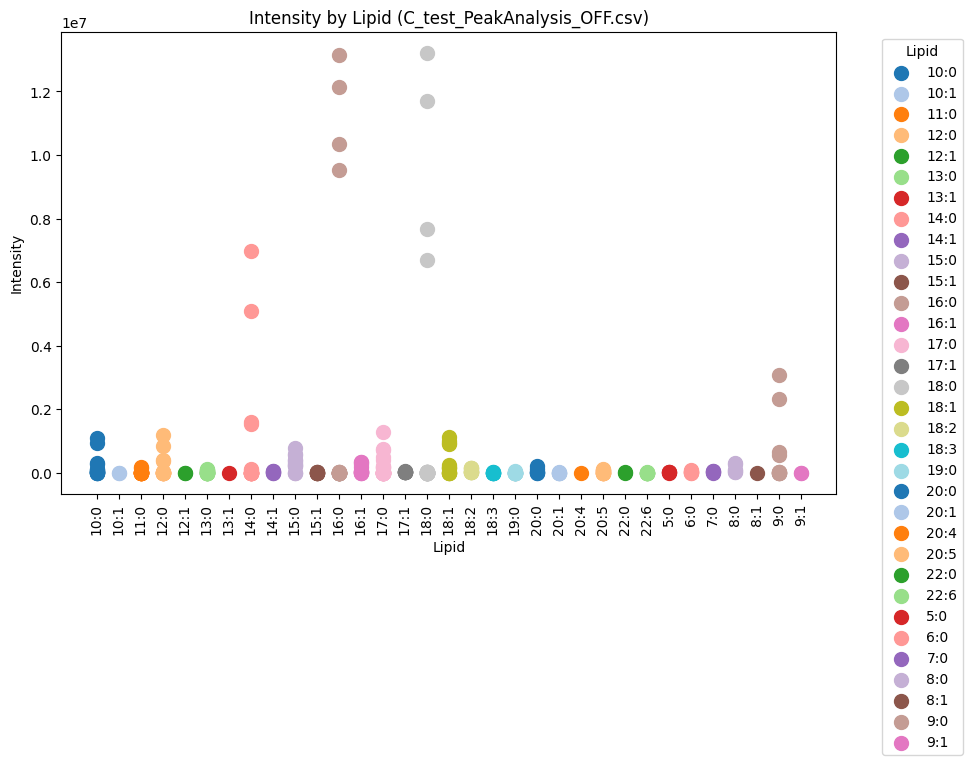

Looking for CSV file at: ./Projects/AMP/results/C_test/csv_data/C_test_PeakAnalysis_OFF.csv
Loaded DataFrame with 390 rows and 17 columns.
DataFrame columns: Index(['Lipid', 'Retention_Time', 'OzESI_Intensity', 'Match_Group',
       'Group_Sample', 'Sample_ID', 'Parent_Ion', 'Product_Ion', 'FAC',
       'Biology', 'Genotype', 'Cage', 'Mouse', 'Peak_Height', 'FWHM',
       'Peak_Width', 'Peak_Area'],
      dtype='object')
Directory already exists at Projects/AMP/results/C_test/plots/off/
Grouped Data:    Lipid  OzESI_Intensity
0   10:0     1.102884e+06
1   10:1     8.730621e+03
2   11:0     1.988830e+05
3   12:0     1.199150e+06
4   12:1     1.118848e+04
5   13:0     1.203990e+05
6   13:1     8.852700e+03
7   14:0     6.982286e+06
8   14:1     6.254175e+04
9   15:0     7.827032e+05
10  15:1     2.986168e+04
11  16:0     1.315654e+07
12  16:1     3.468492e+05
13  17:0     1.299440e+06
14  17:1     4.565360e+04
15  18:0     1.321664e+07
16  18:1     1.116997e+06
17  18:2     1.635724e+05


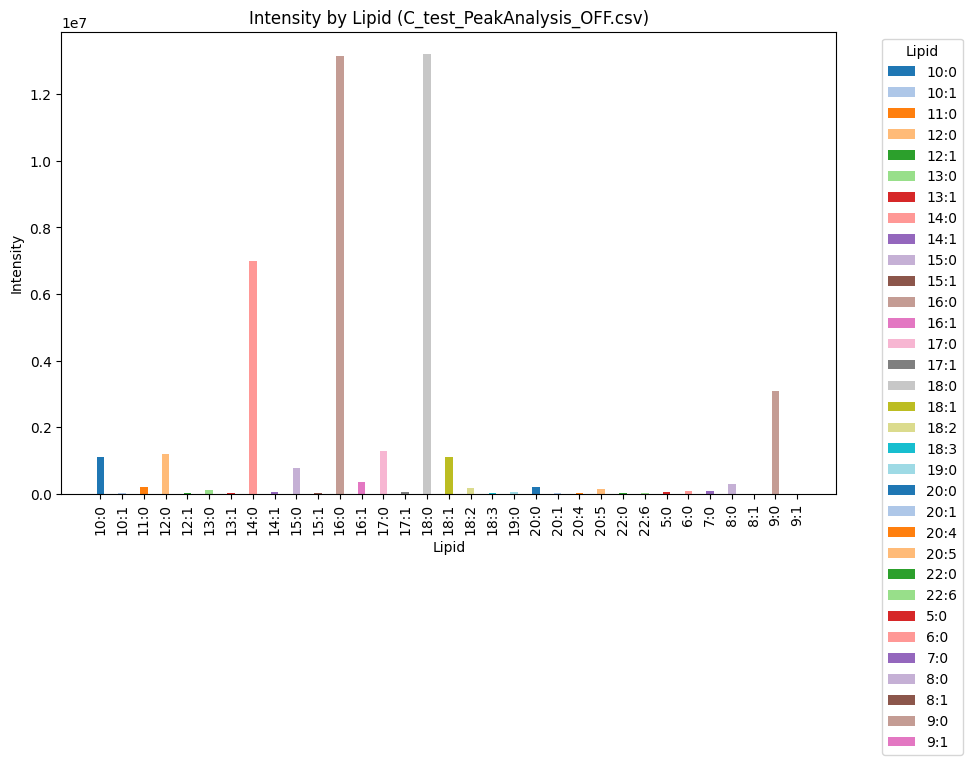

In [17]:


# Initialize the Plot class
plotter = Plot(csv_data_folder, peak_analysis_csv_on, peak_analysis_csv_off, ozone_compare_csv, plots_directory)

# Create a scatter plot with use_ozone_compare argument
plotter.scatter(use_ozone_compare=False, mode=mode)

# Create a bar plot with use_ozone_compare argument
plotter.plot_bar(use_ozone_compare=False, mode=mode)


# # Create bar plots by group sample with use_ozone_compare argument
# plotter.plot_bar_by_group_sample(use_ozone_compare=True, mode='ON', group_type='Match_Group')


Looking for CSV file at: ./Projects/AMP/results/C_test/csv_data/C_test_OFF.csv_OzoneCompared.csv
Loaded DataFrame with 332 rows and 19 columns.
DataFrame columns: Index(['Lipid', 'Retention_Time', 'OzESI_Intensity', 'Match_Group',
       'Group_Sample', 'Sample_ID', 'Parent_Ion', 'Product_Ion', 'FAC',
       'Biology', 'Genotype', 'Cage', 'Mouse', 'Peak_Height', 'FWHM',
       'Peak_Width', 'Peak_Area', 'FAC_OFF', 'Retention_Time_OFF'],
      dtype='object')
Directory already exists at Projects/AMP/results/C_test/plots/off/
Grouped Data:                                                Lipid  OzESI_Intensity
0  10:0 / 18:2 (9Z,12Z)n-6,n-9 / 14:1 (9Z)n-5 / 1...     6.856845e+05
1               11:0 / 15:1 (10Z)n-5 / 17:1 (10Z)n-7     1.023703e+05
2                                               16:1     1.348215e+05
3                                               18:1     4.424109e+05
4                       18:2 / 20:3 (11Z,14Z,17Z)n-3     5.868634e+04
5  20:3 (8Z,11Z,14Z)n-6,n-9,n-12 / 1

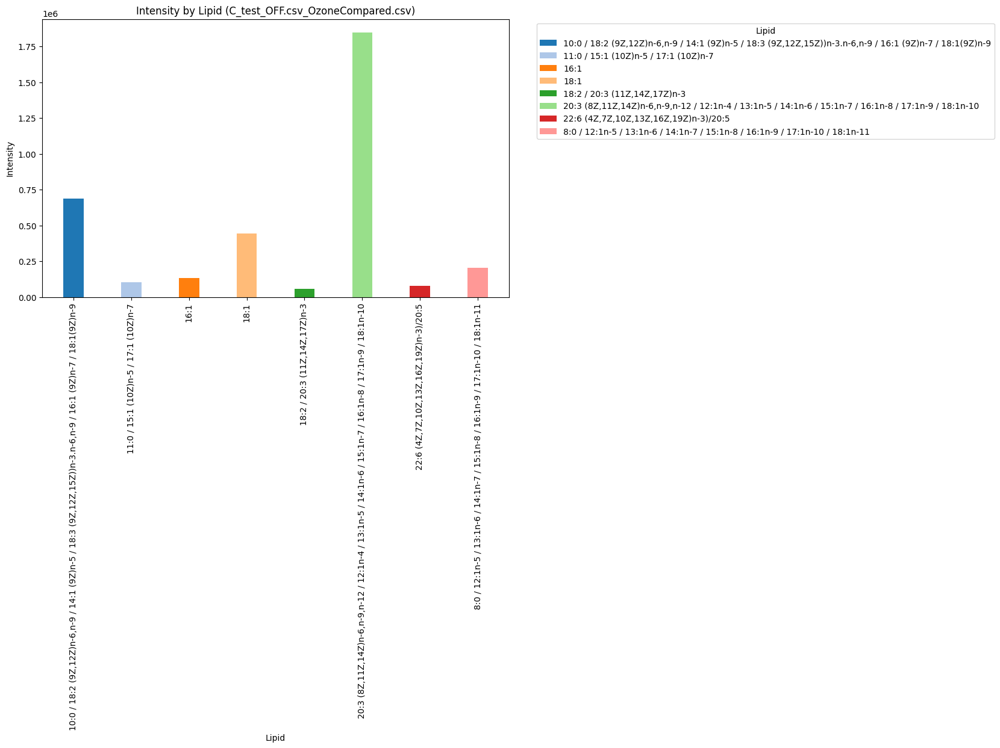

In [18]:
# Create a bar plot with use_ozone_compare argument
plotter.plot_bar(use_ozone_compare=True, mode=mode)

Looking for CSV file at: ./Projects/AMP/results/C_test/csv_data/C_test_PeakAnalysis_OFF.csv
Loaded DataFrame with 390 rows and 17 columns.
DataFrame columns: Index(['Lipid', 'Retention_Time', 'OzESI_Intensity', 'Match_Group',
       'Group_Sample', 'Sample_ID', 'Parent_Ion', 'Product_Ion', 'FAC',
       'Biology', 'Genotype', 'Cage', 'Mouse', 'Peak_Height', 'FWHM',
       'Peak_Width', 'Peak_Area'],
      dtype='object')
Directory already exists at Projects/AMP/results/C_test/plots/off/


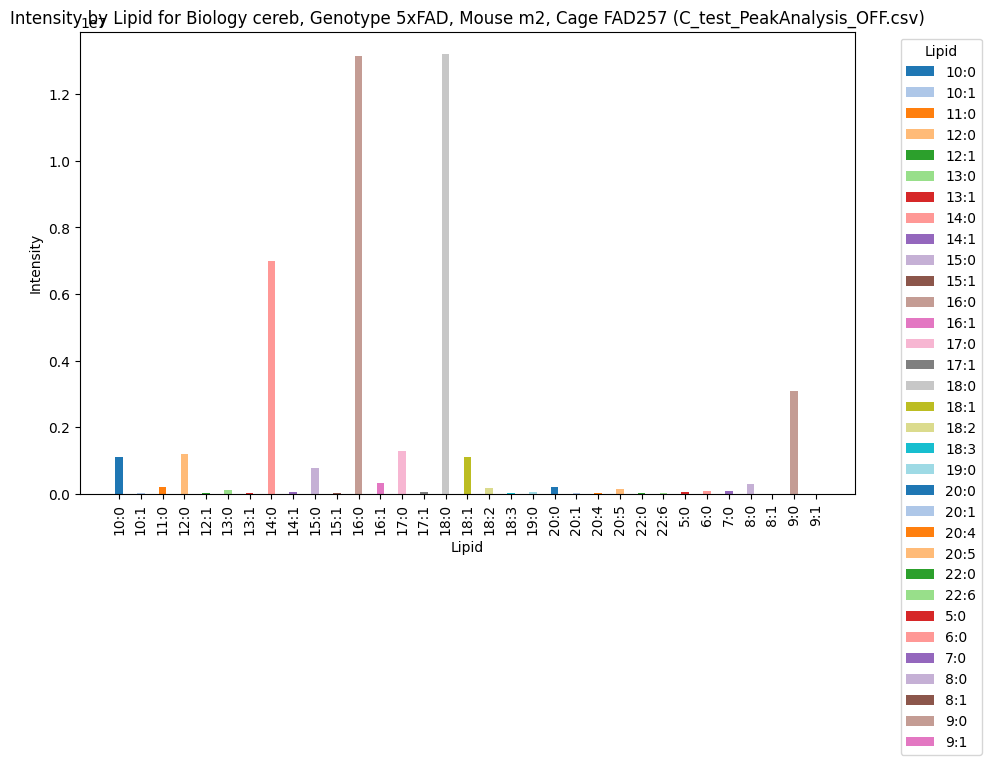

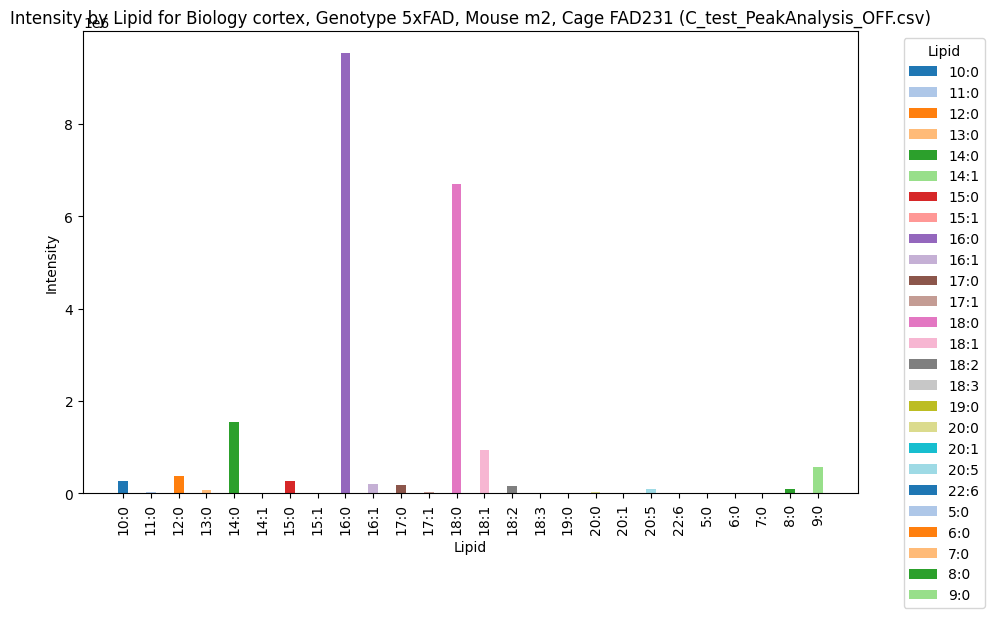

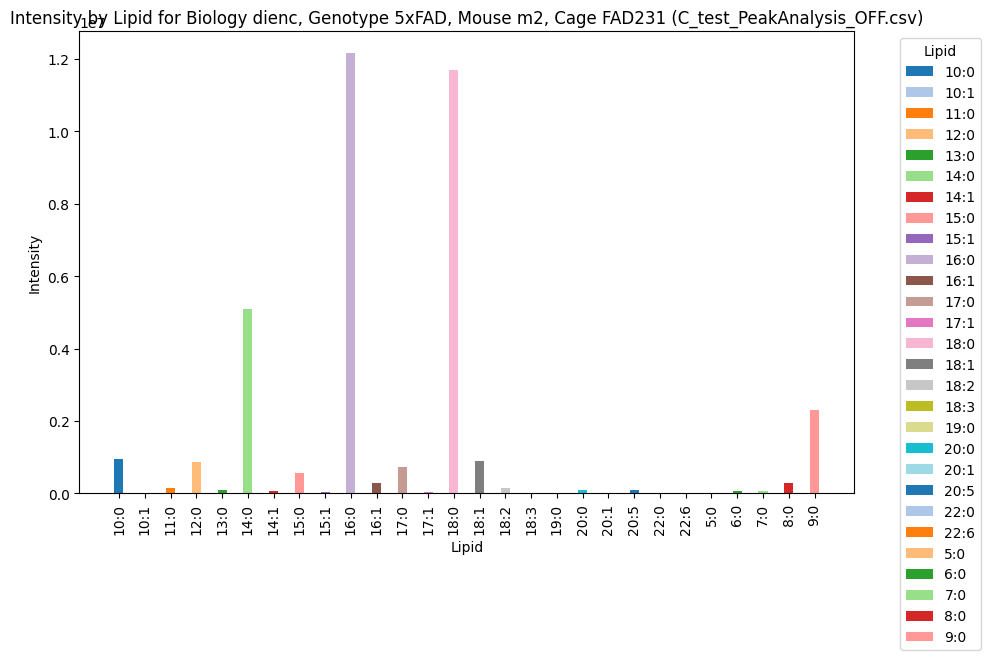

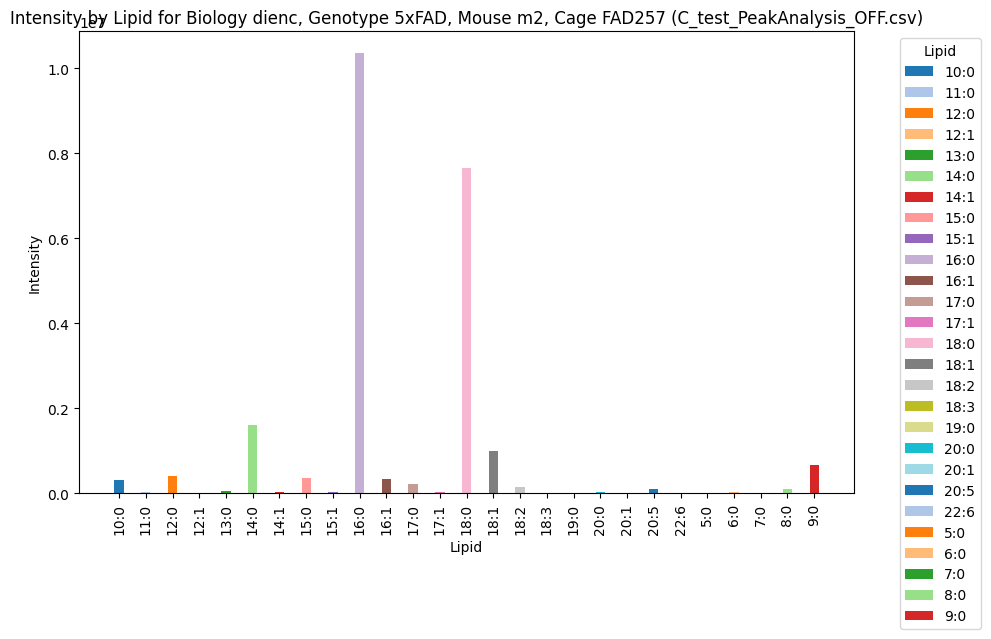

In [19]:
plotter.plot_bar_by_group_sample(use_ozone_compare=False, mode=mode, group_type='Group_Sample')

Looking for CSV file at: ./Projects/AMP/results/C_test/csv_data/C_test_OFF.csv_OzoneCompared.csv
Loaded DataFrame with 332 rows and 19 columns.
DataFrame columns: Index(['Lipid', 'Retention_Time', 'OzESI_Intensity', 'Match_Group',
       'Group_Sample', 'Sample_ID', 'Parent_Ion', 'Product_Ion', 'FAC',
       'Biology', 'Genotype', 'Cage', 'Mouse', 'Peak_Height', 'FWHM',
       'Peak_Width', 'Peak_Area', 'FAC_OFF', 'Retention_Time_OFF'],
      dtype='object')
Directory already exists at Projects/AMP/results/C_test/plots/off/


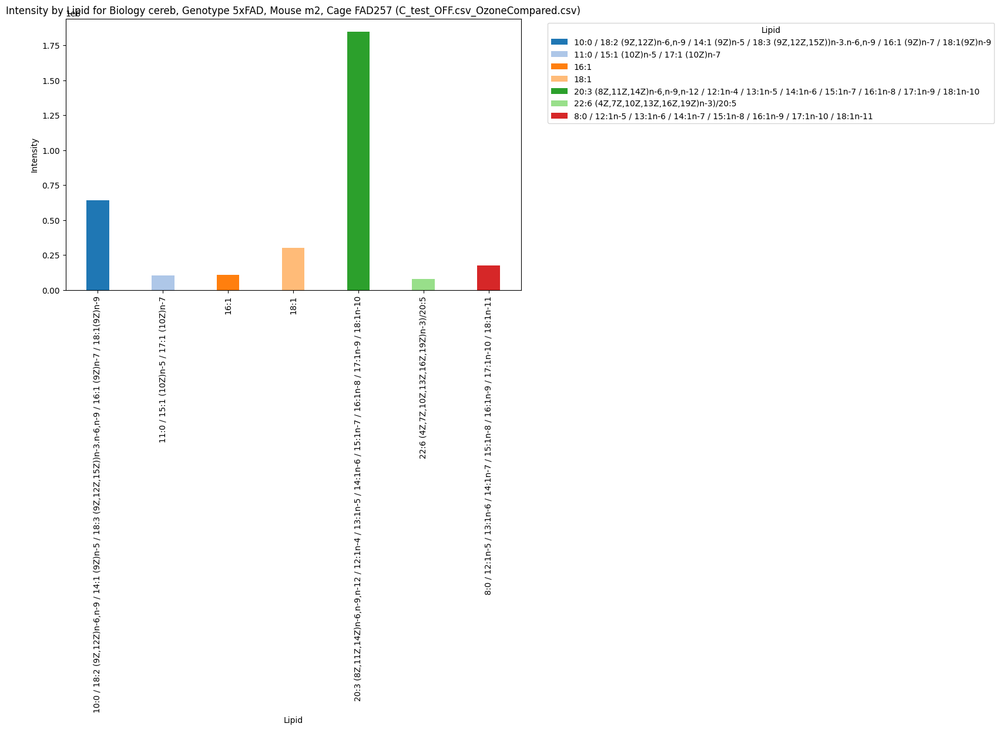

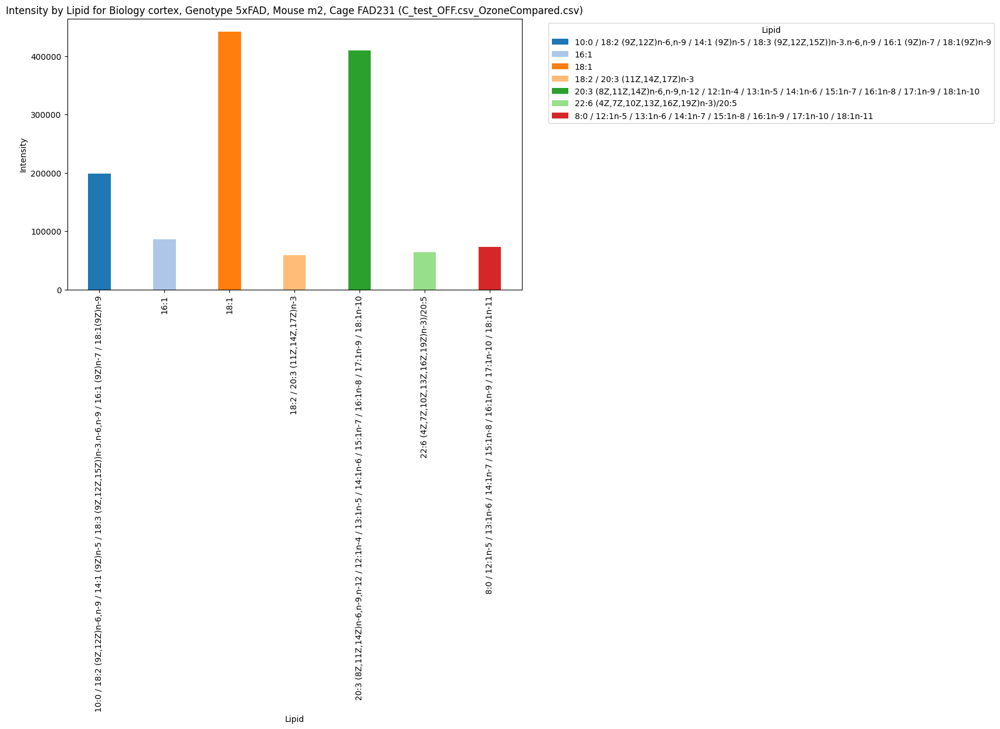

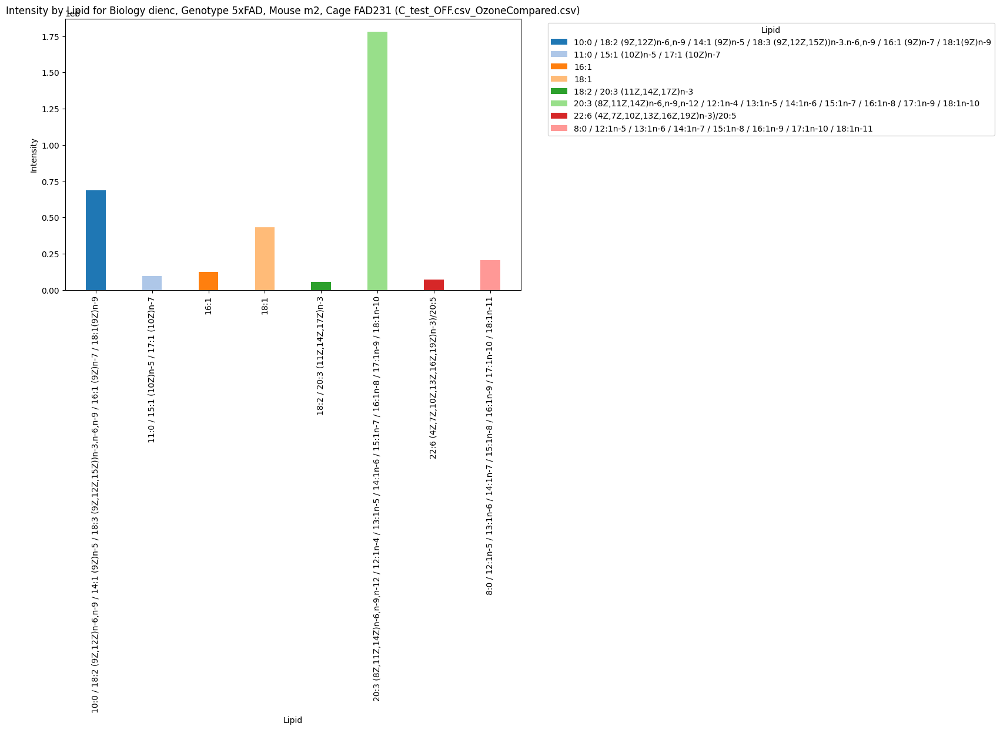

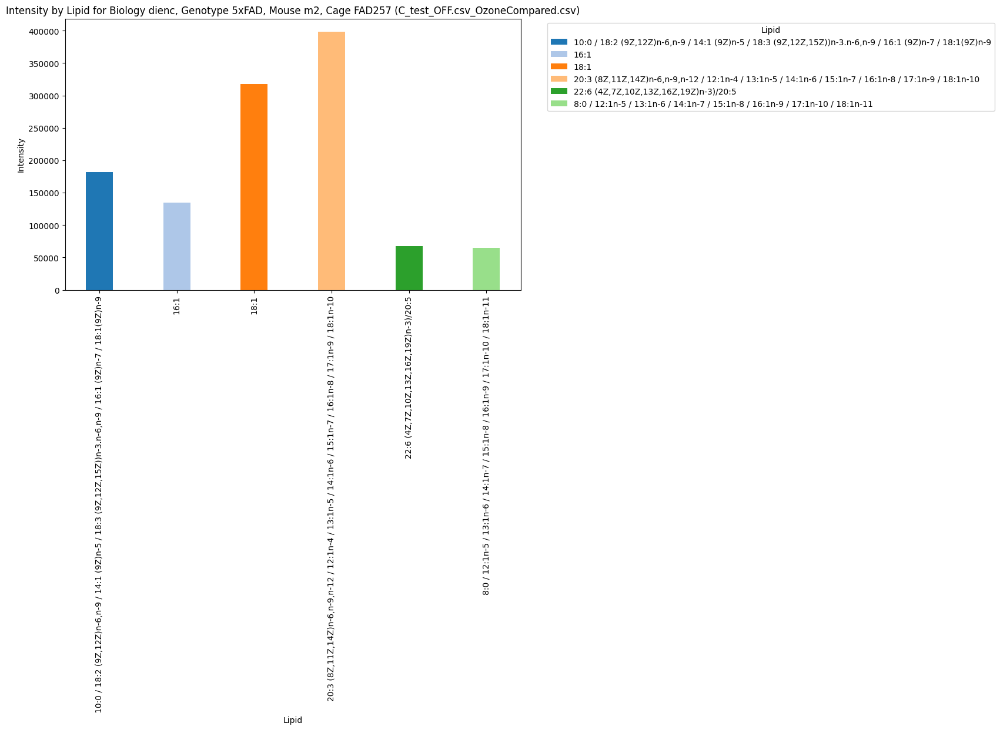

In [20]:
plotter.plot_bar_by_group_sample(use_ozone_compare=True, mode=mode, group_type='Group_Sample')